# AIA24 GraphML Session 05
## Shallow Embeddings and Graph Neural Networks

#**<font color = "grey" >Dependencies**

In [ ]:
# !pip install osmnx
# # !pip uninstall numba               #will be pending untill you type y in the bar below
# !python3 -m pip install numba
# # !pip install momepy
# !pip install dgl
# !pip install node2vec
# !pip install karateclub
# !pip install ipython==7.10.0

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 107.2/107.2 kB 1.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.5/8.5 MB 23.6 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.19.3-py3-none-manylinu

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 777.0/777.0 kB 6.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 14.6 MB/s eta 0:00:00
  Attempting uninstall: ipython
    Found existing installation: ipython 7.34.0
    Uninstalling ipython-7.34.0:
      Successfully uninstalled ipython-7.34.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires ipython==7.34.0, but you have ipython 7.10.0 which is incompatible.
google-colab 1.0.0 requires pandas==2.0.3, but you have pandas 1.3.5 which is incompatible.


Restart Session

In [ ]:
import osmnx as ox
%matplotlib inline
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
import pandas as pd
import geopandas as gpd
# import momepy
from sklearn.cluster import KMeans
from karateclub.node_embedding.neighbourhood.deepwalk import DeepWalk
from node2vec import Node2Vec
from node2vec.edges import HadamardEmbedder
from node2vec.edges import AverageEmbedder
from node2vec.edges import WeightedL1Embedder
from node2vec.edges import WeightedL2Embedder
import dgl
import torch.nn as nn
import torch.nn.functional as F
from dgl.nn import SAGEConv
from collections import Counter
import torch
from tqdm import tqdm
import matplotlib.patches as mpatches
from shapely.geometry import Point, box

DGL backend not selected or invalid.  Assuming PyTorch for now.


Setting the default backend to "pytorch". You can change it in the ~/.dgl/config.json file or export the DGLBACKEND environment variable.  Valid options are: pytorch, mxnet, tensorflow (all lowercase)


#**<font color = "skyblue" >Introduction to Embeddings**  📖

**What is node embedding and why do we need to perform it to do a learning task on graph data?**

Suppose we have a graph that we want to cluster its nodes, how are we going to represent these nodes? Given that the only information we have is which nodes are connected by edges.

A first thought could be having a tabular dataset where each node is just a row in the table..but we don't have **features** to represent the nodes as columns of the table..it is just the connectivity what we have. <font color = "green" >Also, even if we have features, how are we going to include information about the nodes connectivity?

*Maybe we can work on the adjacency matrix of the graph?*

Let's try this on the following graph..

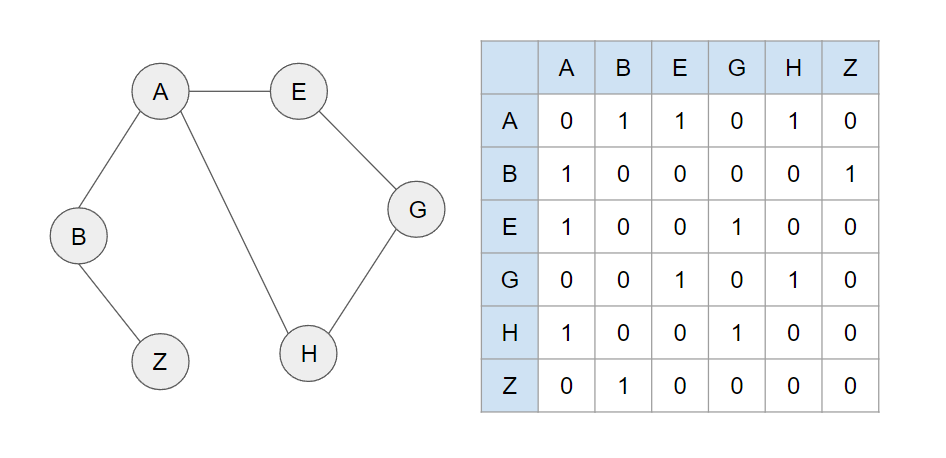

This approach seems working..but it has **two main problems**:

1. We can have a different adjacency matrix if we change the **order of the nodes**, even though the graph is exactly the same. If we have a dataset of multipple graphs.. how do we maintain a unified order between them? There is usually no spatial locality in graph data..

2. The size of the adjacency matrix increases with the number of nodes..a graph of 1000 nodes will have a (1000 x 1000) adj. matrix, which means each node will be represented by a vector of 1000..This is highly inefficient in machine learning  <font color = "red" >(**Curse of Dimensionality**)

This means we need to "embedd" the information we have about our graph to a lower dimensional space that **respects the graph structure**.

---

#**<font color = "pink" >Shallow Embeddings**

Shallow Embeddings algorithms learn to embedd graph nodes to a lower dimensional space (let's say a node is represented in the embedding space by a  vector of size = 2), so that they **preserve neighborhoods**, i.e. connected or nearby nodes should be embedded closer in the embedding space, while unrelated nodes should be far.

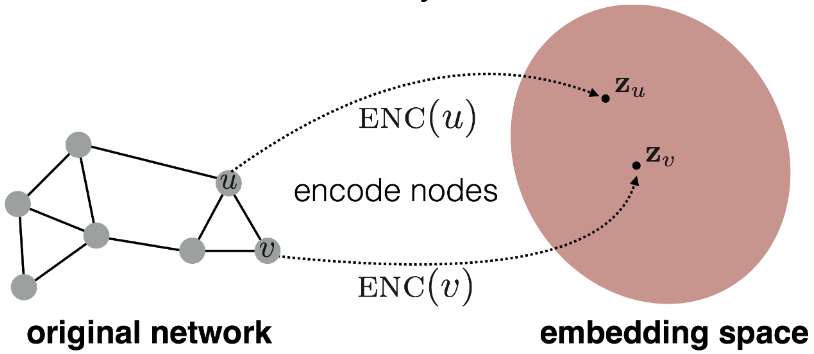

[image source](https://pytorch-geometric.readthedocs.io/en/latest/tutorial/shallow_node_embeddings.html#:~:text=Node2Vec%20is%20a%20method%20for,first%20or%20depth%2Dfirst%20samplers.)

---

These techniques only consider graph structure, but they don't take into account node or edge **features**..*This will be explained in the Deep embeddings.*

**Get a graph.. and perform clustering on its embedded nodes using different embedding algorithms**  

We will use 2 embedding techniques, ***DeepWalk*** and ***Node2vec***.. there are many other shallow embeddings methods you can explore, some of them are:

-**Graph Factorization**

-**Higher-order proximity preserved embedding (HOPE)**

-**Graph representation with global structure information (GraphRep)**

In [ ]:
point = 41.41290, 2.10680 #https://nominatim.openstreetmap.org/ui/reverse.html?lat=41.41290&lon=2.10680&zoom=18
dist = 1000
G = ox.graph_from_point(point,  dist=dist, network_type='drive', simplify=True)

In [ ]:
#Retrieve nodes and edges from the graph
nodes, edges = ox.graph_to_gdfs(G)

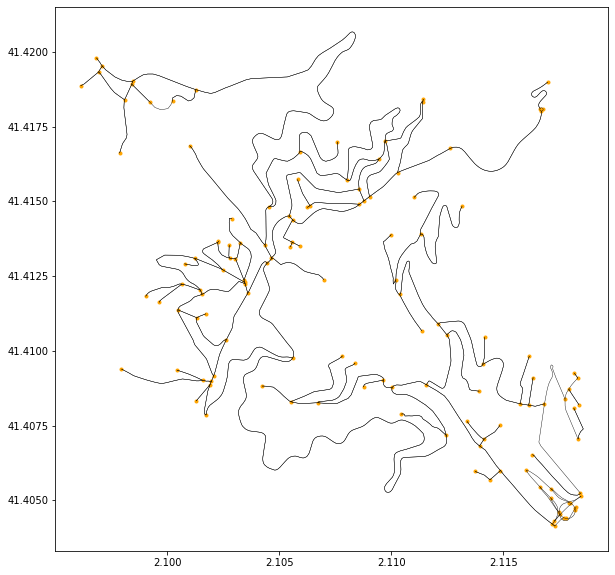

In [ ]:
fig, ax = plt.subplots(figsize=(10,10))

edges.plot(ax=ax, linewidth=0.4, edgecolor='black')
nodes.plot(ax=ax, color='orange', markersize=9)
plt.show()

---

**Deepwalk**

[paper](https://arxiv.org/abs/1403.6652)

Deepwalk is an algorithm that learns nodes embeddings by simulating uniform randm walks. *What does that mean?*

Let's first explore a little about something called the **Skip-Gram** that is widely used in language models (when data is in a form of text).

A skip gram is a well known architecture used to represent words (text data) as numbers, so the machine can understand and learn from.

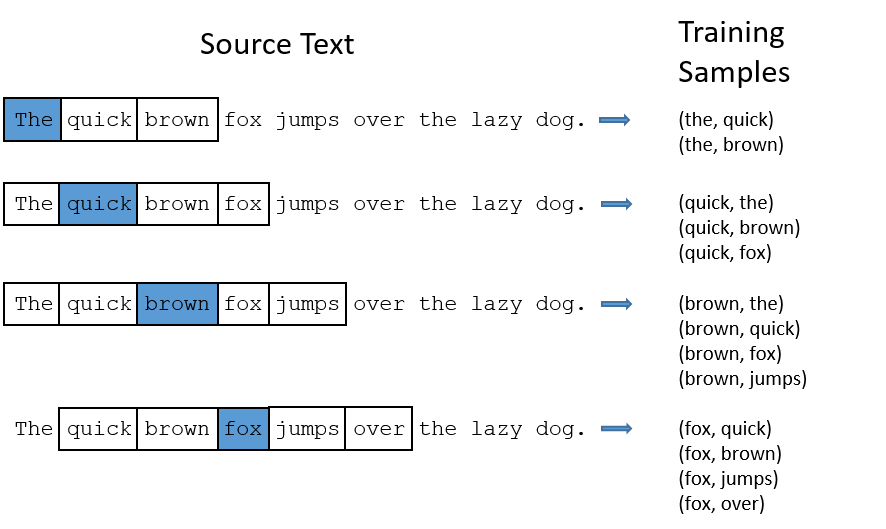

[image source](https://mccormickml.com/assets/word2vec/training_data.png)

We need this so we embed or represent words that have similar meanings close in the embeddings space. For example, we expect words like "**urban**" and "**map**" to be embedded closer than words "**urban**" and "**cat**".  

How to train a model to do this? A famous algorithm called skip-gram does so by sampling a pair of words, a central word as an input and words close to it in the text (using a window size), so it suggests that words mentioned close to each other usually share the same context.

**Graphs borrow this idea from Language models, but rather than a sliding window used to embed close words together, a random walk from a node to its neighbours (connected nodes by edges).**

In [ ]:
G_copy= G.copy() #Note that GraRep and DeepWalk may change the input graph
G_copy= nx.relabel_nodes(G_copy, {j:i for i,j in enumerate(G_copy.nodes)})  #relabel nodes index..
dw_dimension=16
dw = DeepWalk(dimensions=dw_dimension,walk_number=10,walk_length=200,window_size=10)
dw.fit(G_copy)
dw_embeddings = dw.get_embedding()
#dw_embeddings

In [ ]:
dw_embeddings

array([[ 2.0443134 ,  1.7180117 , -2.4026163 , ..., -0.3454703 ,
        -1.766419  ,  0.38143188],
       [ 0.78975505, -1.0157899 , -1.1814058 , ..., -0.1842857 ,
        -0.36751208, -2.3288016 ],
       [ 2.9361105 , -1.4985689 ,  0.61652315, ..., -3.5330389 ,
        -0.17753923,  0.36291224],
       ...,
       [-2.2353065 , -0.6724227 , -0.98970956, ..., -1.1399984 ,
        -0.02427913,  1.0410085 ],
       [-2.2198145 , -0.39425436, -2.2027903 , ..., -1.350128  ,
         0.39930713,  1.9930981 ],
       [-1.8128701 , -2.3904061 ,  0.36147022, ..., -3.210714  ,
        -2.184787  , -2.3953676 ]], dtype=float32)

In [ ]:
kmeans = KMeans(n_clusters=4, random_state=0, n_init="auto").fit(dw_embeddings)
#kmeans.labels_

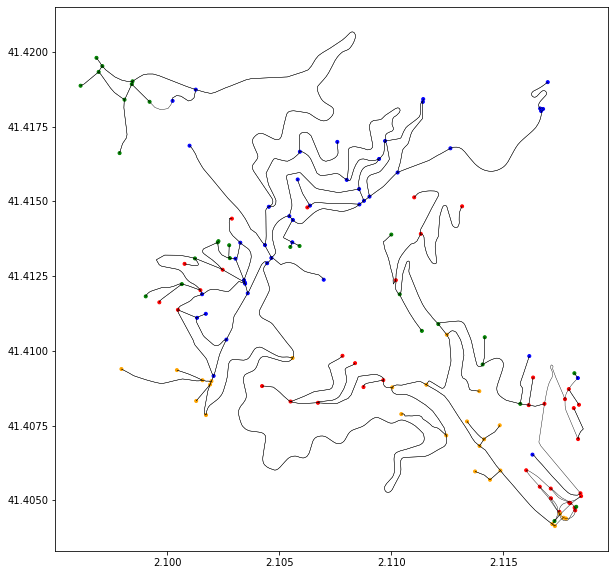

In [ ]:
colors_dict={0:"red", 1:"blue", 2:"orange", 3:"green", 4:"pink", 5:"purple", 6:"yellow"}
fig, ax = plt.subplots(figsize=(10,10))
colors=[colors_dict[i] for i in kmeans.labels_]
edges.plot(ax=ax, linewidth=0.4, edgecolor='black')
nodes.plot(ax=ax, color=colors, markersize=9)
plt.show()

We can see more or less the connected nodes are clusterd together, <font color ="blue"> however clusters are not very well defined..

Now let's visualize the embeddings space using **T-SNE** since it is more than a 3d vector

In [ ]:
from sklearn.manifold import TSNE
tow_d_embedding = TSNE(n_components=2, learning_rate=100,init='random', perplexity=30 ,n_iter=3000, random_state=1).fit_transform(dw_embeddings)
tow_d_embedding.shape

(135, 2)

Text(0.5, 1.0, '2D T-SNE visualization of the 16D DeepWalk embeddings')

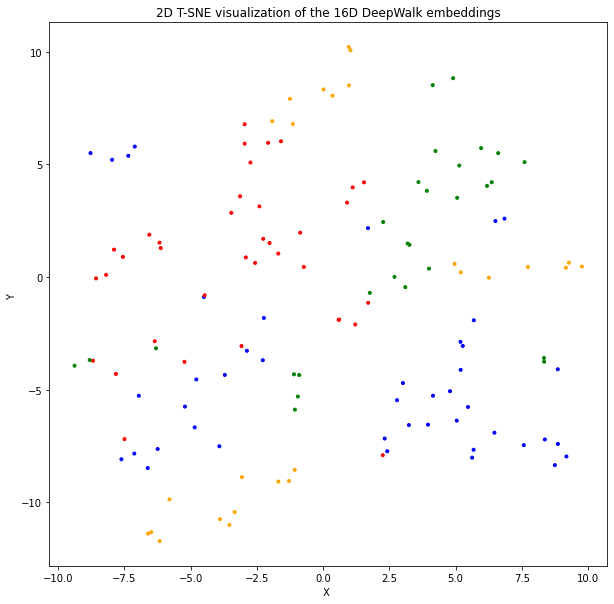

In [ ]:
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(1,1,1)
ax.scatter(tow_d_embedding[:,0] ,tow_d_embedding[:,1]  ,c=colors, s=9 , alpha=1) #color the nodes using the kmeans clusters

ax.set_xlabel('X ')
ax.set_ylabel('Y ')

plt.title(f'2D T-SNE visualization of the {dw_dimension}D DeepWalk embeddings')

<font color ="magenta"> Let's see if another algorithm (Node2Vec) can embed the same graph nodes more reasonably

---
---

**Node2vec**

[paper](https://arxiv.org/pdf/1607.00653)

The main difference between Node2Vec and DeepWalk is that in Node2Vec the walks are sampled in a **biased** way instead of completely random.

In [ ]:
#Calculate node embeddings ..
embedding_dimension=8  #try different embedding size..see wich gives more accurate clustering results
node2vec = Node2Vec(G, dimensions=embedding_dimension,seed=0)
model = node2vec.fit(window=5)

Computing transition probabilities:   0%|          | 0/135 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 10/10 [00:00<00:00, 25.08it/s]


In [ ]:
n2v_embeddings = model.wv   #model.wv.vectors gives wrong nodes order

In [ ]:
ordered_embeddings=[]
for x in G.nodes():
  ordered_embeddings.append(n2v_embeddings[str(x)]) #since the output is a keyed vector,  v = n2v_embeddings[x] will give wrong nodes (missing up with the order)
ordered_embeddings_arr=np.array(ordered_embeddings) #create an array with the correct node order

In [ ]:
kmeans = KMeans(n_clusters=4, random_state=0, n_init="auto").fit(ordered_embeddings_arr)
#kmeans.labels_

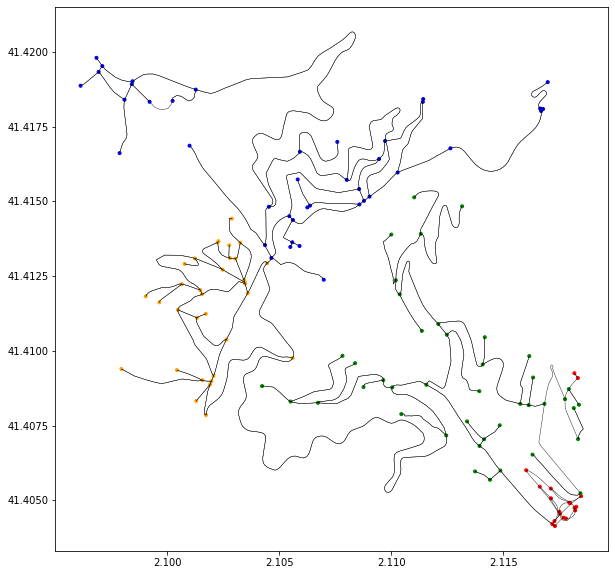

In [ ]:
colors_dict={0:"red", 1:"blue", 2:"orange", 3:"green", 4:"pink", 5:"purple", 6:"yellow"}
fig, ax = plt.subplots(figsize=(10,10))
colors=[colors_dict[i] for i in kmeans.labels_]
edges.plot(ax=ax, linewidth=0.4, edgecolor='black')
nodes.plot(ax=ax, color=colors, markersize=9)
plt.show()

<font color = "red" > **Important Note**: Notice that this is just using information of the graph structure.. **the nodes location (x,y) is NOT** used in either the embedding or the clustering

Also visualize the embeddings space using **T-SNE**

In [ ]:
from sklearn.manifold import TSNE
tow_d_embedding = TSNE(n_components=2, learning_rate=100,init='random', perplexity=30 ,n_iter=3000, random_state=1).fit_transform(ordered_embeddings_arr)
tow_d_embedding.shape

(135, 2)

Text(0.5, 1.0, '2D T-SNE visualization of the 8D Node2vec embeddings')

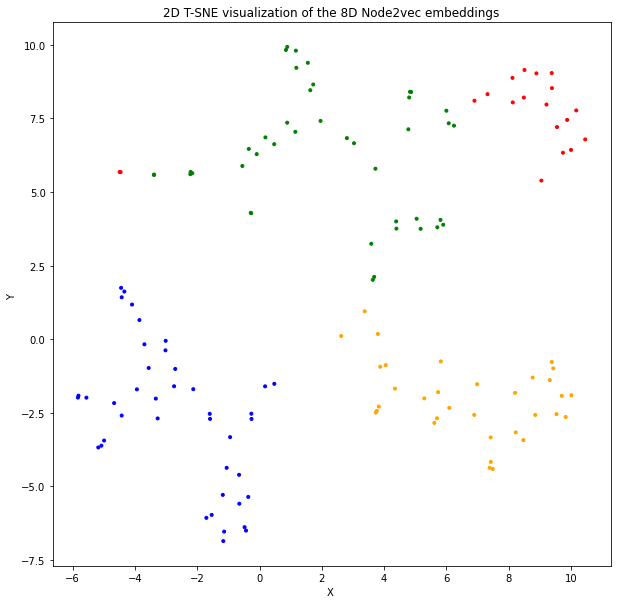

In [ ]:
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(1,1,1)
ax.scatter(tow_d_embedding[:,0] ,tow_d_embedding[:,1]  ,c=colors, s=9 , alpha=1) #color the nodes using the kmeans clusters

ax.set_xlabel('X ')
ax.set_ylabel('Y ')

plt.title(f'2D T-SNE visualization of the {embedding_dimension}D Node2vec embeddings')

**We can see that the algorithm mostly embedded the connected nodes closer in the embedding space**

---
---

**Edge2vec**

The main idea of Edge2Vec is to use the node embedding of two adjacent nodes to perform some basic mathematical operations in order to extract the embedding of the edge connecting them.

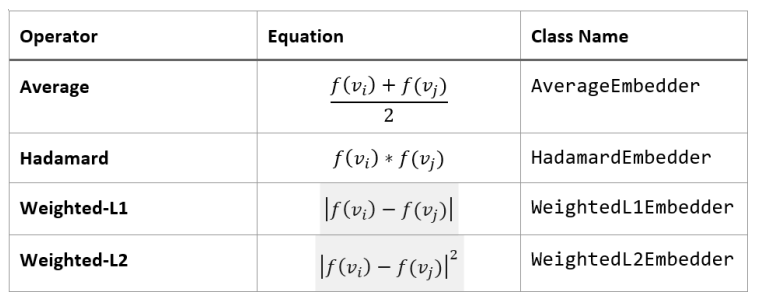

In [ ]:
e2v_embedding_1= HadamardEmbedder(keyed_vectors=model.wv)
ordered_e2v_1=np.array([e2v_embedding_1[(str(x[0]), str(x[1]))] for x in G.edges()]) #get the embeddings in the correct edges order..,check e2v_embedding_1[(str(256680583),str(1071339362))] edge pair of nodes

e2v_embedding_2= AverageEmbedder(keyed_vectors=model.wv)
ordered_e2v_2=np.array([e2v_embedding_2[(str(x[0]), str(x[1]))] for x in G.edges()])

e2v_embedding_3= WeightedL1Embedder(keyed_vectors=model.wv)
ordered_e2v_3=np.array([e2v_embedding_3[(str(x[0]), str(x[1]))] for x in G.edges()])

e2v_embedding_4= WeightedL2Embedder(keyed_vectors=model.wv)
ordered_e2v_4=np.array([e2v_embedding_4[(str(x[0]), str(x[1]))] for x in G.edges()])

Cluster the graph edges according to the learned embeddings

In [ ]:
kmeans_e2v_1 = KMeans(n_clusters=4, random_state=0, n_init="auto").fit(ordered_e2v_1)
kmeans_e2v_2 = KMeans(n_clusters=4, random_state=0, n_init="auto").fit(ordered_e2v_2)
kmeans_e2v_3 = KMeans(n_clusters=4, random_state=0, n_init="auto").fit(ordered_e2v_3)
kmeans_e2v_4 = KMeans(n_clusters=4, random_state=0, n_init="auto").fit(ordered_e2v_4)

kmeans_e2v_all=[kmeans_e2v_1, kmeans_e2v_2, kmeans_e2v_3, kmeans_e2v_4]

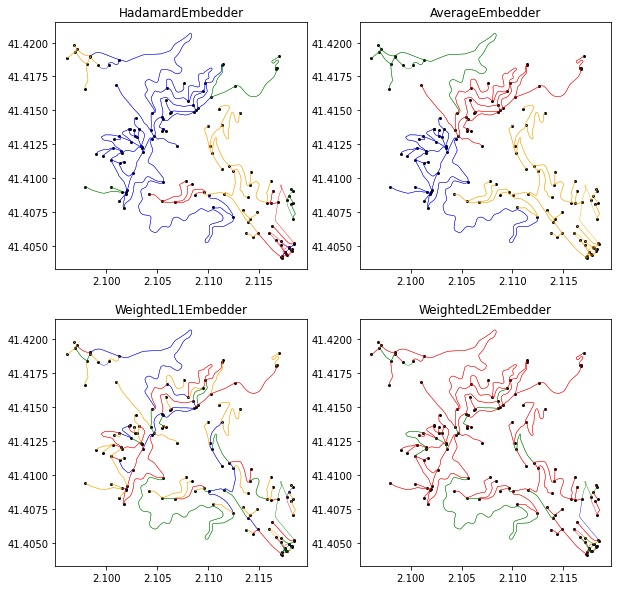

In [ ]:
fig = plt.figure(figsize=(10,10))

colors_dict={0:"red", 1:"blue", 2:"orange", 3:"green", 4:"pink", 5:"purple", 6:"yellow"}
titles=["HadamardEmbedder", "AverageEmbedder", "WeightedL1Embedder", "WeightedL2Embedder"]

for i in range(4):
  ax = fig.add_subplot(2,2,i+1)
  e_colors=[colors_dict[i] for i in kmeans_e2v_all[i].labels_]

  edges.plot(ax=ax, linewidth=0.4, edgecolor=e_colors)
  nodes.plot(ax=ax, color="black", markersize=4)

  ax.set_title(titles[i])

---
---

#**<font color = "pink" >Deep Embeddings - Graph Neural Networks**

##Node Classification

###Get the graph and assign node **features**


In order to perform a node classification task on a graph, we will need two types of information to assign to the nodes:
1. **Features**, these features represent the **input X**, that we need to know about each node to do a prediction task on it. **This information should be complete.**
2. **Classes**, the **output Y** that we need to predict, since we are in a semi-supervised setting, **we don't necessarily need to know the output of all nodes**, we just need it for some nodes to learn on, then we will use the model to predict the rest of unpredicted classes.

In [ ]:
place_name= "Barcelona, Barcelonès, Barcelona, Catalonia, 08001, Spain"
G = ox.graph_from_place(place_name, network_type='walk', simplify=True) #other network types: drive, bike, drive_service, all, all_private

pcs="epsg:32642"  #project the graph from a geographic to a projected coordinates system
G=ox.project_graph(G,to_crs=pcs)

In [ ]:
#Retrieve nodes and edges from the graph
nodes, edges = ox.graph_to_gdfs(G)

In [ ]:
#Get boundary area by a place name
boundary = ox.geocode_to_gdf(place_name)
boundary=ox.projection.project_gdf(boundary, to_crs=pcs, to_latlong=False)      #project

---

Let's start by the node attributes(features)

**[Map Features](https://wiki.openstreetmap.org/wiki/Map_features)**

check the link to find more possible keys like amenity, buildinfg,...etc.


In [ ]:
tags4={'natural': 'tree'} #	A single tree
tree= ox.geometries_from_place(place_name, tags4)

tags5={'natural': 'wood'} # Tree-covered area (a 'forest' or 'wood')
wood= ox.geometries_from_place(place_name, tags5)

tags6={'natural': 'scrub'} # Uncultivated land covered with shrubs, bushes or stunted trees.
scrub= ox.geometries_from_place(place_name, tags6)


<ipython-input-21-47824660b239>:2: FutureWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in the v2.0.0 release. See the OSMnx v2 migration guide: https://github.com/gboeing/osmnx/issues/1123
  tree= ox.geometries_from_place(place_name, tags4)
<ipython-input-21-47824660b239>:5: FutureWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in the v2.0.0 release. See the OSMnx v2 migration guide: https://github.com/gboeing/osmnx/issues/1123
  wood= ox.geometries_from_place(place_name, tags5)
<ipython-input-21-47824660b239>:8: FutureWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `featu

Check the type of data in each geodataframe

In [ ]:
print(f'tree : {Counter(tree["geometry"].geom_type)}')
print(f'wood : {Counter(wood["geometry"].geom_type)}')
print(f'scrub : {Counter(scrub["geometry"].geom_type)}')
print("*******************************************************")

tree : Counter({'Point': 22377})
wood : Counter({'Polygon': 68, 'Point': 1, 'MultiPolygon': 1})
scrub : Counter({'Polygon': 166})
*******************************************************


In [ ]:
tree['geometry']=tree['geometry'].to_crs(pcs)     #project to the coordinate system
wood['geometry']=wood['geometry'].to_crs(pcs)
scrub['geometry']=scrub['geometry'].to_crs(pcs)

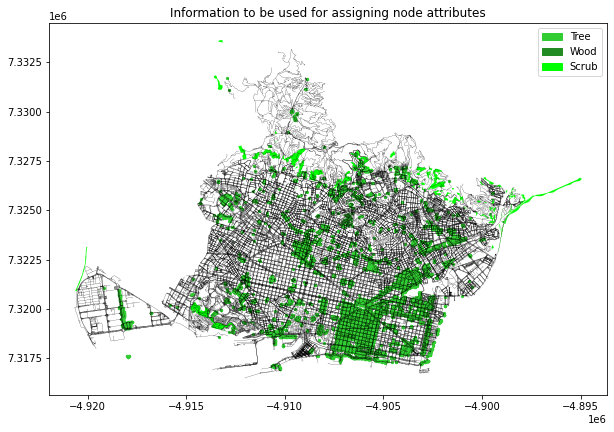

In [ ]:
fig, ax = plt.subplots(figsize=(10,10))
#boundary.plot(ax=ax, facecolor='gray')
edges.plot(ax=ax, linewidth=0.1, edgecolor='black')
nodes.plot(ax=ax, color='black', markersize=0.0003)

tree.plot(ax=ax,facecolor='limegreen',color="limegreen", markersize=5)
wood.plot(ax=ax,facecolor='forestgreen',color="forestgreen", markersize=5)
scrub.plot(ax=ax,facecolor='lime',color="lime", markersize=5)

#create a legend
tree_patch = mpatches.Patch(color='limegreen', label='Tree')
wood_patch = mpatches.Patch(color='forestgreen', label='Wood')
scrub_patch = mpatches.Patch(color='lime', label='Scrub')

plt.legend(handles=[tree_patch, wood_patch, scrub_patch] )
ax.set_title("Information to be used for assigning node attributes")
plt.show()

📖
We will use the above points/polygons to assign attributes represent vegetation to the Graph Nodes. **Instead of assigning an attribute to only the closest graph node to the point/polygon centroid, we will assign the attribute to all the graph nodes in a certain defined distance to the point/polygon**. This should make more sense than choosing just one node.

**Get the centroids**

In [ ]:
tree_points=tree['geometry'].centroid
print(tree_points)

wood_points=wood['geometry'].centroid
print(wood_points)

scrub_points=scrub['geometry'].centroid
print(scrub_points)

element_type  osmid      
node          899553867      POINT (-4907027.023 7326210.255)
              899553868      POINT (-4907034.824 7326211.760)
              899553870      POINT (-4907050.705 7326208.668)
              899553871      POINT (-4907051.157 7326202.069)
              899553882      POINT (-4907045.422 7326204.678)
                                           ...               
              11903715105    POINT (-4904311.265 7327142.038)
              11903715106    POINT (-4904322.930 7327148.220)
              11903715107    POINT (-4904304.470 7327154.456)
              11903715108    POINT (-4904312.908 7327158.398)
              11903715109    POINT (-4904320.352 7327161.418)
Length: 22377, dtype: geometry
element_type  osmid     
node          1241562471    POINT (-4912803.582 7331102.848)
way           50166097      POINT (-4907045.816 7326335.075)
              50166099      POINT (-4907174.581 7326426.835)
              50218044      POINT (-4906914.841 73264

⭐ Notice that here the points of the polygons or the points are not indexed from 0 to N, they are indexed by osmid. We need both polygons/points and graph nodes to be indexed from 0 to N. (N is the length of the geodataframe -1). Let's first create a bounding box from each point.

**Create bounding boxes of each centroid to get the graph nodes inside thses boxes**

<font color= "red" > Side Note: please be aware that this may not be the best strategy especially if your dataset has mostly irregular shapes of polygons.

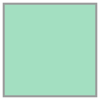

In [ ]:
trial_centroid= (1,1)
trial_width=20
box(minx=trial_centroid[0]-trial_width/2, miny=trial_centroid[1]-trial_width/2, maxx=trial_centroid[0]+trial_width/2, maxy=trial_centroid[1]+trial_width/2)

In [ ]:
width=500
tree_boxes=gpd.GeoSeries([box(minx=c.x - width/2, miny=c.y - width/2, maxx=c.x + width/2, maxy=c.y + width/2) for c in tree_points])
wood_boxes=gpd.GeoSeries([box(minx=c.x - width/2, miny=c.y - width/2, maxx=c.x + width/2, maxy=c.y + width/2) for c in wood_points])
scrub_boxes=gpd.GeoSeries([box(minx=c.x - width/2, miny=c.y - width/2, maxx=c.x + width/2, maxy=c.y + width/2) for c in scrub_points])

In [ ]:
print(tree_boxes, wood_boxes,scrub_boxes )

0        POLYGON ((-4906777.023 7325960.255, -4906777.0...
1        POLYGON ((-4906784.824 7325961.760, -4906784.8...
2        POLYGON ((-4906800.705 7325958.668, -4906800.7...
3        POLYGON ((-4906801.157 7325952.069, -4906801.1...
4        POLYGON ((-4906795.422 7325954.678, -4906795.4...
                               ...                        
22372    POLYGON ((-4904061.265 7326892.038, -4904061.2...
22373    POLYGON ((-4904072.930 7326898.220, -4904072.9...
22374    POLYGON ((-4904054.470 7326904.456, -4904054.4...
22375    POLYGON ((-4904062.908 7326908.398, -4904062.9...
22376    POLYGON ((-4904070.352 7326911.418, -4904070.3...
Length: 22377, dtype: geometry 0     POLYGON ((-4912553.582 7330852.848, -4912553.5...
1     POLYGON ((-4906795.816 7326085.075, -4906795.8...
2     POLYGON ((-4906924.581 7326176.835, -4906924.5...
3     POLYGON ((-4906664.841 7326158.087, -4906664.8...
4     POLYGON ((-4911985.071 7325023.094, -4911985.0...
                            ...         

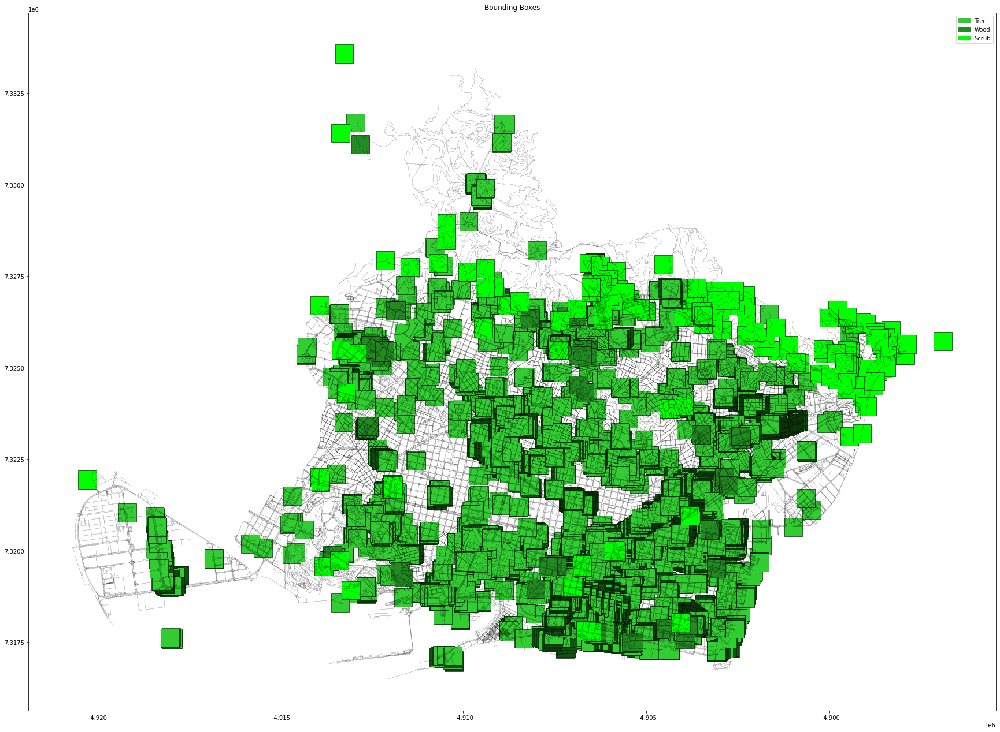

In [ ]:
fig, ax = plt.subplots(figsize=(30,30))
#boundary.plot(ax=ax, facecolor='gray')
edges.plot(ax=ax, linewidth=0.1, edgecolor='black')
nodes.plot(ax=ax, color='black', markersize=0.0003)

tree_boxes.plot(ax=ax,facecolor='limegreen',color="limegreen", markersize=5, edgecolor="black", linewidth=0.6)
wood_boxes.plot(ax=ax,facecolor='forestgreen',color="forestgreen", markersize=5, edgecolor="black", linewidth=0.6)
scrub_boxes.plot(ax=ax,facecolor='lime',color="lime", markersize=5, edgecolor="black", linewidth=0.6)

#create a legend
tree_patch = mpatches.Patch(color='limegreen', label='Tree')
wood_patch = mpatches.Patch(color='forestgreen', label='Wood')
scrub_patch = mpatches.Patch(color='lime', label='Scrub')

plt.legend(handles=[tree_patch, wood_patch, scrub_patch] )
ax.set_title("Bounding Boxes")
plt.show()

⭐ Now the boxes are indexed by spatial index rather than osmid, let's also get points indeed by spatial index from the Graph Nodes.

In [ ]:
#Convert the graph nodes to shapely points
Points_from_Nodes = gpd.GeoSeries(gpd.points_from_xy(list(nodes['x']),list(nodes['y'])))
print(Points_from_Nodes)

0        POINT (-4910296.742 7317306.489)
1        POINT (-4910304.936 7317296.552)
2        POINT (-4910299.305 7317311.897)
3        POINT (-4910226.491 7317341.791)
4        POINT (-4910322.392 7317269.324)
                       ...               
72422    POINT (-4907196.916 7325779.327)
72423    POINT (-4907507.302 7324804.845)
72424    POINT (-4907491.180 7324815.516)
72425    POINT (-4913394.559 7325011.724)
72426    POINT (-4904326.811 7327054.996)
Length: 72427, dtype: geometry


In [ ]:
#Create a dictionary where {key:value} = {Point spatialIndex : Node osmid}  ⭐⭐⭐
nodes_osmid=list(nodes.index)                      #list of nodes indicies in osmnx graph
Points_spatialindex=list(Points_from_Nodes.index)  #list of  spatial indicies of the created points

osmId_spatialIndex={}
[osmId_spatialIndex.update({i:j}) for i,j in zip(Points_spatialindex ,nodes_osmid)]
len(nodes_osmid)

72427

In [ ]:
nearest_points_spatial_index_to_trees=Points_from_Nodes.sindex.query(tree_boxes)
print(f'centroids and graph nodes spatial index - Trees {nearest_points_spatial_index_to_trees}')  #[0] first array is the indicies of each box and [1] the second array is the indicies of the included graph points
print(nearest_points_spatial_index_to_trees.shape)

nearest_points_spatial_index_to_woods=Points_from_Nodes.sindex.query(wood_boxes)
print(f'centroids and graph nodes spatial index - Woods{nearest_points_spatial_index_to_woods}')   #[0] first array is the indicies of each box and [1] the second array is the indicies of the included graph points
print(nearest_points_spatial_index_to_woods.shape)

nearest_points_spatial_index_to_scrubs=Points_from_Nodes.sindex.query(scrub_boxes)
print(f'centroids and graph nodes spatial index - Scrubs{nearest_points_spatial_index_to_scrubs}') #[0] first array is the indicies of each box and [1] the second array is the indicies of the included graph points
print(nearest_points_spatial_index_to_scrubs.shape)

centroids and graph nodes spatial index - Trees [[    0     0     0 ... 22376 22376 22376]
 [66763 66775 59769 ... 17051 55020 36504]]
(2, 3189898)
centroids and graph nodes spatial index - Woods[[    0     1     1 ...    69    69    69]
 [17727 25711 15515 ...  9443 71061 71725]]
(2, 8431)
centroids and graph nodes spatial index - Scrubs[[    0     0     0 ...   165   165   165]
 [40454 18269 55755 ... 39434 39433 39432]]
(2, 10698)


Let's now see **for each node in the graph**, how many times it has been selected by the bounding boxes of :
- tree
- wood
- scrub

Let's create a dictionary keyed by the graph point spatial index and valued by a list represents how many times this point was selected by a tree, a wood and a scrub.

**example**: ⭐

{232 : [2, 4, 0]}

This means graph point of spatial index 232, was selected by 2 bounding boxes of trees, 4 bounding boxes of woods and 0 bounding box of scrubs.

In [ ]:
trees_counter=Counter(nearest_points_spatial_index_to_trees[1])
woods_counter=Counter(nearest_points_spatial_index_to_woods[1])
scurbs_counter=Counter(nearest_points_spatial_index_to_scrubs[1])

points_selections={}
for i in tqdm(Points_from_Nodes.index):
  points_selections[i]=[]
  points_selections[i].append(trees_counter[i])  #how many times selected by trees (if the node index is not in the counter, it will return 0)
  points_selections[i].append(woods_counter[i])  #how many times selected by woods (if the node index is not in the counter, it will return 0)
  points_selections[i].append(scurbs_counter[i]) #how many times selected by scrubs(if the node index is not in the counter, it will return 0)

100%|██████████| 72427/72427 [00:00<00:00, 517385.55it/s]


In [ ]:
print(points_selections)

{0: [7, 0, 0], 1: [8, 0, 0], 2: [5, 0, 0], 3: [4, 0, 0], 4: [15, 0, 0], 5: [22, 0, 0], 6: [22, 0, 0], 7: [0, 0, 0], 8: [0, 0, 0], 9: [0, 0, 0], 10: [0, 0, 0], 11: [0, 0, 0], 12: [0, 0, 0], 13: [0, 0, 0], 14: [0, 0, 0], 15: [0, 0, 0], 16: [0, 0, 0], 17: [0, 0, 0], 18: [0, 0, 0], 19: [0, 0, 0], 20: [0, 0, 0], 21: [0, 0, 0], 22: [0, 0, 0], 23: [0, 0, 0], 24: [0, 0, 0], 25: [0, 0, 0], 26: [0, 0, 0], 27: [0, 0, 0], 28: [0, 0, 0], 29: [0, 0, 0], 30: [0, 0, 0], 31: [0, 0, 0], 32: [0, 0, 0], 33: [0, 0, 0], 34: [0, 0, 0], 35: [0, 0, 0], 36: [0, 0, 0], 37: [0, 0, 0], 38: [0, 0, 0], 39: [2, 0, 0], 40: [2, 0, 0], 41: [2, 0, 0], 42: [2, 0, 0], 43: [2, 0, 0], 44: [0, 0, 0], 45: [0, 0, 0], 46: [0, 0, 0], 47: [0, 0, 0], 48: [0, 0, 0], 49: [0, 0, 0], 50: [0, 0, 0], 51: [0, 0, 0], 52: [0, 0, 0], 53: [0, 0, 0], 54: [0, 0, 0], 55: [0, 0, 0], 56: [0, 0, 0], 57: [0, 0, 0], 58: [2, 0, 0], 59: [2, 0, 0], 60: [2, 0, 0], 61: [2, 0, 0], 62: [2, 0, 0], 63: [2, 0, 0], 64: [90, 0, 0], 65: [88, 0, 0], 66: [93, 0, 0]

Checking...

In [ ]:
for i,j in zip(points_selections.keys(),points_selections.values()):
  if j[0]!=0 and j[1]!=0 and j[2]!=0:
    pass           #comment
    #print(i , j)  #uncomment to check points that have been selected by trees/woods/scurbs

Define a rule to assign attributes to the nodes based on their selection times..

Let's say for example that we will just give each node a number represent how many times it has been selected by a tree or a wood or a scrub.. Later add these features to the **nodes geodataframe** of the Graph, we can also use the dictionary `osmId_spatialIndex` we created earlier, to make sure the attributes are assigned to the right nodes in the geodataframe.

In [ ]:
print(osmId_spatialIndex )

{0: 21638843, 1: 6831738685, 2: 8462014250, 3: 6831706284, 4: 21638845, 5: 885308258, 6: 885308314, 7: 21638855, 8: 1401485279, 9: 4229056903, 10: 6831706278, 11: 21638859, 12: 3643971036, 13: 689473874, 14: 6831706254, 15: 21638861, 16: 6984806821, 17: 3643971040, 18: 9249495240, 19: 21638867, 20: 6984972069, 21: 1636238503, 22: 6984972072, 23: 6984972066, 24: 21638868, 25: 30343649, 26: 8253197813, 27: 8253197816, 28: 30343654, 29: 21638869, 30: 30343672, 31: 242318729, 32: 6984972029, 33: 6984972026, 34: 21638877, 35: 7159121700, 36: 6984927533, 37: 6984927536, 38: 6984927539, 39: 21638878, 40: 4433359262, 41: 6984927548, 42: 7159121709, 43: 7159121706, 44: 21638882, 45: 7159098030, 46: 7159194692, 47: 8984401689, 48: 8984401691, 49: 21638886, 50: 5006930486, 51: 6984806805, 52: 8253214823, 53: 21638889, 54: 3107096656, 55: 21638890, 56: 7254139889, 57: 8253147513, 58: 7254139891, 59: 21638891, 60: 190983324, 61: 8253147438, 62: 242284801, 63: 7254139899, 64: 21638916, 65: 21638917,

In [ ]:
nodes

<frozen importlib._bootstrap>:914: ImportWarning: _PyDrive2ImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _PyDriveImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _GenerativeAIImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _OpenCVImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: APICoreClientInfoImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _BokehImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _AltairImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _PyDrive2ImportHook.find_spec() not found; falling back to find_module()
<frozen impo

,y,x,street_count,lon,lat,highway,ref,geometry
osmid,,,,,,,,
21638843,7.317306e+06,-4.910297e+06,3,2.187593,41.370365,NaN,NaN,POINT (-4910296.742 7317306.489)
6831738685,7.317297e+06,-4.910305e+06,4,2.187627,41.370285,crossing,NaN,POINT (-4910304.936 7317296.552)
8462014250,7.317312e+06,-4.910299e+06,4,2.187542,41.370370,NaN,NaN,POINT (-4910299.305 7317311.897)
6831706284,7.317342e+06,-4.910226e+06,4,2.187666,41.370875,crossing,NaN,POINT (-4910226.491 7317341.791)
21638845,7.317269e+06,-4.910322e+06,3,2.187743,41.370092,NaN,NaN,POINT (-4910322.392 7317269.324)
...,...,...,...,...,...,...,...,...
11882035043,7.325779e+06,-4.907197e+06,1,2.140435,41.417339,NaN,NaN,POINT (-4907196.916 7325779.327)
11882082426,7.324805e+06,-4.907507e+06,1,2.146082,41.412191,NaN,NaN,POINT (-4907507.302 7324804.845)
11882082430,7.324816e+06,-4.907491e+06,3,2.146080,41.412318,NaN,NaN,POINT (-4907491.180 7324815.516)


In [ ]:
nodes["trees"]= [i[0] for i in points_selections.values()]
nodes["woods"]= [i[1] for i in points_selections.values()]
nodes["scrubs"]= [i[2] for i in points_selections.values()]
nodes

,y,x,street_count,lon,lat,highway,ref,geometry,trees,woods,scrubs
osmid,,,,,,,,,,,
21638843,7.317306e+06,-4.910297e+06,3,2.187593,41.370365,NaN,NaN,POINT (-4910296.742 7317306.489),7,0,0
6831738685,7.317297e+06,-4.910305e+06,4,2.187627,41.370285,crossing,NaN,POINT (-4910304.936 7317296.552),8,0,0
8462014250,7.317312e+06,-4.910299e+06,4,2.187542,41.370370,NaN,NaN,POINT (-4910299.305 7317311.897),5,0,0
6831706284,7.317342e+06,-4.910226e+06,4,2.187666,41.370875,crossing,NaN,POINT (-4910226.491 7317341.791),4,0,0
21638845,7.317269e+06,-4.910322e+06,3,2.187743,41.370092,NaN,NaN,POINT (-4910322.392 7317269.324),15,0,0
...,...,...,...,...,...,...,...,...,...,...,...
11882035043,7.325779e+06,-4.907197e+06,1,2.140435,41.417339,NaN,NaN,POINT (-4907196.916 7325779.327),78,0,0
11882082426,7.324805e+06,-4.907507e+06,1,2.146082,41.412191,NaN,NaN,POINT (-4907507.302 7324804.845),5,0,0
11882082430,7.324816e+06,-4.907491e+06,3,2.146080,41.412318,NaN,NaN,POINT (-4907491.180 7324815.516),5,0,0


You may also want to add other structural features to the nodes like degrees, or any other **centrality based attributes**.

In this example, w can cluster the nodes according to their proximity, since we expect nodes within same clusters should more or less share similar class.

In [ ]:
nodes_xy=[[nodes.loc[i].geometry.x, nodes.loc[i].geometry.y] for i in tqdm(nodes.index)]

100%|██████████| 72427/72427 [00:48<00:00, 1497.55it/s]


In [ ]:
kmeans = KMeans(n_clusters=7, random_state=0, n_init="auto").fit(nodes_xy)
#kmeans.labels_

KeyboardInterrupt: 

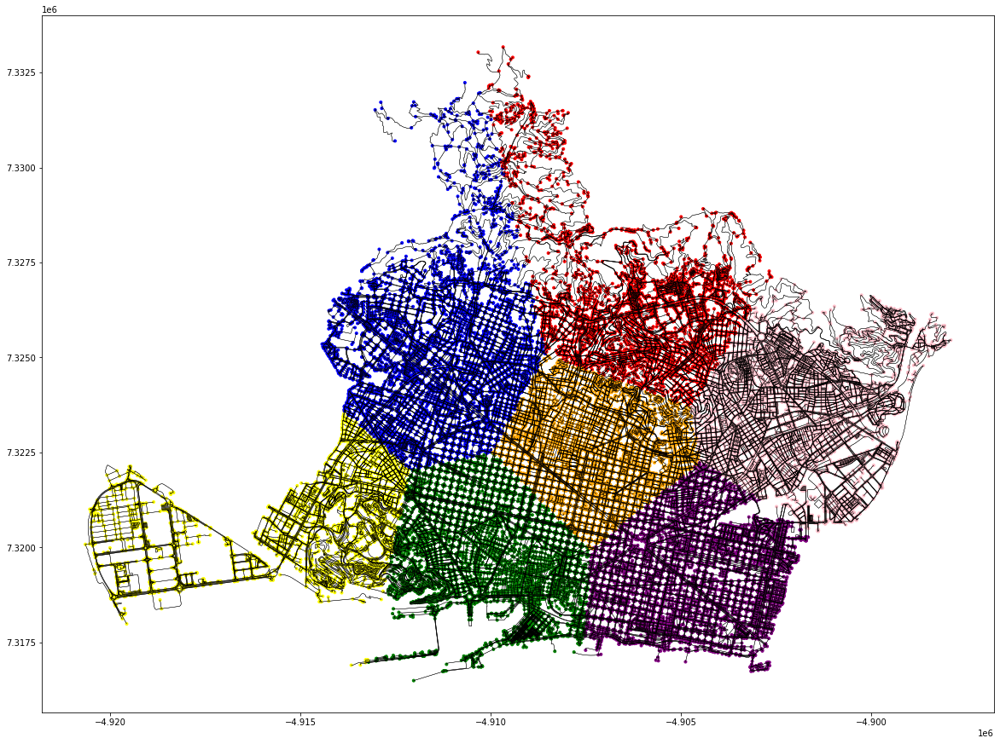

In [ ]:
colors_dict={0:"red", 1:"blue", 2:"orange", 3:"green", 4:"pink", 5:"purple", 6:"yellow"}
fig, ax = plt.subplots(figsize=(20,20))
colors=[colors_dict[i] for i in kmeans.labels_]
edges.plot(ax=ax, linewidth=0.4, edgecolor='black')
nodes.plot(ax=ax, color=colors, markersize=9)
plt.show()

Assign the cluster index to each node in the nodes geodataframe

In [ ]:
nodes["proximity_cluster_index"]=kmeans.labels_
nodes

,y,x,street_count,lon,lat,highway,ref,geometry,trees,woods,scrubs,classes,proximity_cluster_index
osmid,,,,,,,,,,,,,
21638843,7.317306e+06,-4.910297e+06,3,2.187593,41.370365,NaN,NaN,POINT (-4910296.742 7317306.489),7,0,0,4,3
6831738685,7.317297e+06,-4.910305e+06,4,2.187627,41.370285,crossing,NaN,POINT (-4910304.936 7317296.552),8,0,0,4,3
8462014250,7.317312e+06,-4.910299e+06,4,2.187542,41.370370,NaN,NaN,POINT (-4910299.305 7317311.897),5,0,0,4,3
6831706284,7.317342e+06,-4.910226e+06,4,2.187666,41.370875,crossing,NaN,POINT (-4910226.491 7317341.791),4,0,0,4,3
21638845,7.317269e+06,-4.910322e+06,3,2.187743,41.370092,NaN,NaN,POINT (-4910322.392 7317269.324),15,0,0,4,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...
11882035043,7.325779e+06,-4.907197e+06,1,2.140435,41.417339,NaN,NaN,POINT (-4907196.916 7325779.327),78,0,0,4,0
11882082426,7.324805e+06,-4.907507e+06,1,2.146082,41.412191,NaN,NaN,POINT (-4907507.302 7324804.845),5,0,0,0,0
11882082430,7.324816e+06,-4.907491e+06,3,2.146080,41.412318,NaN,NaN,POINT (-4907491.180 7324815.516),5,0,0,0,0


**Visualize the graph according to each feature**

KeyboardInterrupt: 

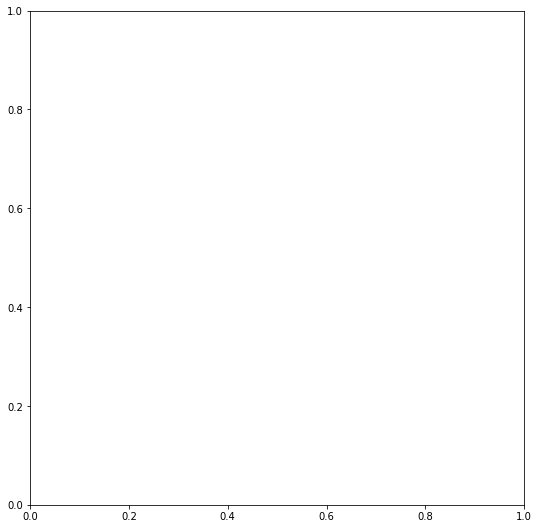

In [ ]:
fig = plt.figure(figsize=(20,20))
unselected='white'
node_size=0.6
edge_color='black'
edge_width=0.03
boyndary_color='ivory'

#trees
ax = fig.add_subplot(2,2,1)
edges.plot(ax=ax, linewidth=edge_width, edgecolor=edge_color)
nodes.plot("trees", ax=ax, cmap=plt.cm.RdYlGn, markersize=node_size , legend=True)
ax.set_title('Trees Nodes')

#woods
ax = fig.add_subplot(2,2,2)
edges.plot(ax=ax, linewidth=edge_width, edgecolor=edge_color)
nodes.plot("woods", ax=ax, cmap=plt.cm.RdYlGn , markersize=node_size , legend=True)
ax.set_title('Woods Nodes')

#scrubs
ax = fig.add_subplot(2,2,3)
edges.plot(ax=ax, linewidth=edge_width, edgecolor=edge_color)
nodes.plot("scrubs", ax=ax, cmap=plt.cm.RdYlGn , markersize=node_size , legend=True)
ax.set_title('Scrubs Nodes')

#proximity clusters

ax = fig.add_subplot(2,2,4)

colors_dict={0:"red", 1:"blue", 2:"orange", 3:"green", 4:"pink", 5:"purple", 6:"yellow"}
c_list_cluster_proximity=[colors_dict[i] for i in list(nodes['proximity_cluster_index'])]


edges.plot(ax=ax, linewidth=edge_width, edgecolor=edge_color)
nodes.plot(ax=ax, c=c_list_cluster_proximity, markersize=node_size)
ax.set_title('Proximity clusters Nodes')

###Assign **Classes** to nodes


So far, we have created the input X , which is the features we assigned for each node in the graph, now, we need to assign the classes **(output Y) to the some nodes we have information about.**

Let's get a dataset that measures **Most vulnerable areas in the city of Barecelona to heat exposure**



In [ ]:
import urllib.request
urllib.request.urlretrieve("https://opendata-ajuntament.barcelona.cat/data/dataset/b89c0c13-14a8-4134-8dc9-1b571fc385d0/resource/b74519d0-c171-46c0-9963-2f8908a0478a/download/ate_vulnera_5-14_od.gpkg", 'file_1.gpkg')

url='/content/file_1.gpkg'
heat_exposure_areas = gpd.read_file(url)

heat_exposure_areas['geometry']=heat_exposure_areas['geometry'].to_crs(pcs)
heat_exposure_areas

<frozen importlib._bootstrap>:914: ImportWarning: _PyDrive2ImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _PyDriveImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _GenerativeAIImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _OpenCVImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: APICoreClientInfoImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _BokehImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _AltairImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _PyDrive2ImportHook.find_spec() not found; falling back to find_module()
<frozen impo

,nRisc,geometry
0,1A,"MULTIPOLYGON (((-4910837.136 7319569.376, -491..."
1,1A,"MULTIPOLYGON (((-4910565.810 7320417.319, -491..."
2,1A,"MULTIPOLYGON (((-4908575.509 7326004.332, -490..."
3,1A,"MULTIPOLYGON (((-4909308.830 7318894.650, -490..."
4,1A,"MULTIPOLYGON (((-4909091.325 7319749.533, -490..."
...,...,...
1708,2AA,"MULTIPOLYGON (((-4903029.093 7324583.232, -490..."
1709,1AA,"MULTIPOLYGON (((-4902681.827 7324477.820, -490..."
1710,1AA,"MULTIPOLYGON (((-4904404.282 7319065.175, -490..."
1711,2AA,"MULTIPOLYGON (((-4904585.413 7319405.692, -490..."


In [ ]:
print(f'heat exposure : {Counter(heat_exposure_areas["geometry"].geom_type)}')

heat exposure : Counter({'MultiPolygon': 1713})


**Dataset Discription**  *(Translated)*

With the aim of delimiting the areas with greater vulnerability due to exposure to heat, the following data crosses the territorialized information on thermal comfort levels with two sets of demographic data:
1) the 2018 register, disaggregated by age groups (0-4, 5-14, 15-34, 36-64, 75 and over) at the scale of residential blocks, to find out where more density of residents, i
2) public facilities, classified according to type and connected to age groups, to identify the areas of the city potentially most used by certain population groups.
With the first data, it has been possible to delimit the areas with the highest density of residents, disaggregated by age groups, while the second have served to identify the areas of the city potentially most used by the various population groups, starting from the hypothesis that the areas with the highest concentration of facilities especially aimed at these audiences are also the ones that will receive the most influx of these groups of people.

Each resource, prior to the selection of a certain age group, allows a map to be generated to observe the overlap between areas with the highest population concentration of the selected demographic group and the areas with the lowest level of thermal comfort, identifying in an indicative manner the areas with greater vulnerability.
It shows, by age group, the population exposed to medium-low, low and very low levels of thermal comfort.
The vulnerable population age group is the sum of the population from 0 to 4 years and 75 years and over. The coincidence of each of the three levels of low thermal comfort with areas of greater density and concentration of equipment generates a gradation of the level of vulnerability that is collected in the following six degrees:
- 1A. Medium-low thermal comfort coinciding with population concentration
- 1AA. Medium-low thermal comfort coinciding with population concentration and facilities
- 2A. Low thermal comfort coinciding with population concentration
- 2AA. Low thermal comfort coinciding with population concentration and equipment
- 3A. Very low thermal comfort coinciding with population concentration
- 3AA. Very low thermal comfort coinciding with population concentration and facilities

In [ ]:
print(f'heat exposure : {Counter(heat_exposure_areas["nRisc"])}')

heat exposure : Counter({'1A': 863, '1AA': 508, '2A': 182, '2AA': 130, '3A': 20, '3AA': 10})


Let's encode these classes as following,

- (1A --> Class 0)
- (1AA --> Class 1)
- (2A --> Class 2)
- (2AA, 3A, 3AA --> Class 3)

In [ ]:
encoded_classes=[]
for i in heat_exposure_areas["nRisc"]:
  if i=='1A':
    encoded_classes.append(0)
  elif i=='1AA':
    encoded_classes.append(1)
  elif i=='2A':
    encoded_classes.append(2)
  elif i=='2AA' or i=='3A' or i=='3AA':
    encoded_classes.append(3)
print(encoded_classes)

[0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 2, 0, 2, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 0, 3, 2, 3, 2, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 

In [ ]:
heat_exposure_areas["encoded_classes"]=encoded_classes
heat_exposure_areas

,nRisc,geometry,encoded_classes
0,1A,"MULTIPOLYGON (((-4910837.136 7319569.376, -491...",0
1,1A,"MULTIPOLYGON (((-4910565.810 7320417.319, -491...",0
2,1A,"MULTIPOLYGON (((-4908575.509 7326004.332, -490...",0
3,1A,"MULTIPOLYGON (((-4909308.830 7318894.650, -490...",0
4,1A,"MULTIPOLYGON (((-4909091.325 7319749.533, -490...",0
...,...,...,...
1708,2AA,"MULTIPOLYGON (((-4903029.093 7324583.232, -490...",3
1709,1AA,"MULTIPOLYGON (((-4902681.827 7324477.820, -490...",1
1710,1AA,"MULTIPOLYGON (((-4904404.282 7319065.175, -490...",1
1711,2AA,"MULTIPOLYGON (((-4904585.413 7319405.692, -490...",3


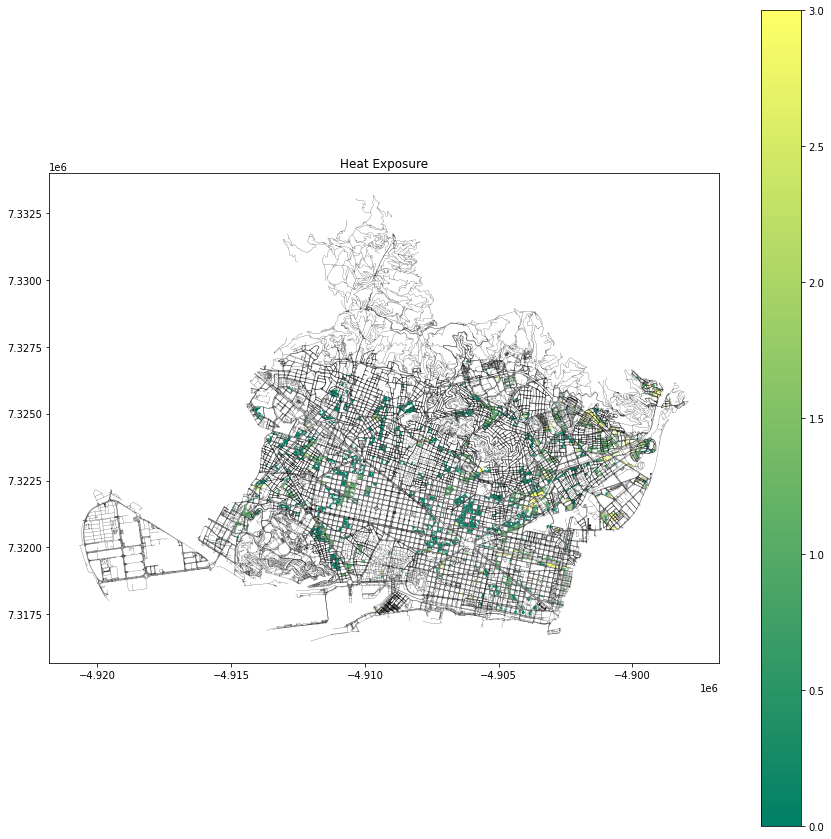

In [ ]:
#PLOTTING (making sure both data fit)
fig,ax = plt.subplots(figsize=(15, 15))

edges.plot(ax=ax, linewidth=0.1 , edgecolor='black')
nodes.plot(ax=ax, color='black', markersize=0.0003)

heat_exposure_areas.plot("encoded_classes", ax=ax, cmap=plt.cm.summer, legend=True)
ax.set_title('Heat Exposure')
plt.show()


Let's do the same steps we did for the features to assign these classes to **some** Graph nodes.

- The difference here is that the nodes have never been selected by any class will ab assigened an **Unknown Class**.

- For the Nodes selected by multipple class, they will be assigned to the class that selected the node more times.

- For example if node 5 was selected 2 times by class 0 (1A) and 7 times by class 1 (1AA), the node will take the second class as its label.

- If the node is selected by multipple classes the same number of times, we can follow a conservative approach and assign it to the class that has higher heat exposure level.

---


In [ ]:
heat_exposure_points=heat_exposure_areas['geometry'].centroid
print(heat_exposure_points)

0       POINT (-4910856.602 7319572.675)
1       POINT (-4910640.886 7320389.089)
2       POINT (-4908595.043 7326047.036)
3       POINT (-4909344.841 7318915.760)
4       POINT (-4909111.833 7319754.670)
                      ...               
1708    POINT (-4903062.301 7324530.523)
1709    POINT (-4902903.366 7324348.268)
1710    POINT (-4904408.263 7319064.734)
1711    POINT (-4904595.973 7319342.099)
1712    POINT (-4904605.712 7319463.224)
Length: 1713, dtype: geometry


In [ ]:
width=300
heat_exposure_boxes=gpd.GeoSeries([box(minx=c.x - width/2, miny=c.y - width/2, maxx=c.x + width/2, maxy=c.y + width/2) for c in heat_exposure_points])

In [ ]:
print(heat_exposure_boxes)

0       POLYGON ((-4910706.602 7319422.675, -4910706.6...
1       POLYGON ((-4910490.886 7320239.089, -4910490.8...
2       POLYGON ((-4908445.043 7325897.036, -4908445.0...
3       POLYGON ((-4909194.841 7318765.760, -4909194.8...
4       POLYGON ((-4908961.833 7319604.670, -4908961.8...
                              ...                        
1708    POLYGON ((-4902912.301 7324380.523, -4902912.3...
1709    POLYGON ((-4902753.366 7324198.268, -4902753.3...
1710    POLYGON ((-4904258.263 7318914.734, -4904258.2...
1711    POLYGON ((-4904445.973 7319192.099, -4904445.9...
1712    POLYGON ((-4904455.712 7319313.224, -4904455.7...
Length: 1713, dtype: geometry


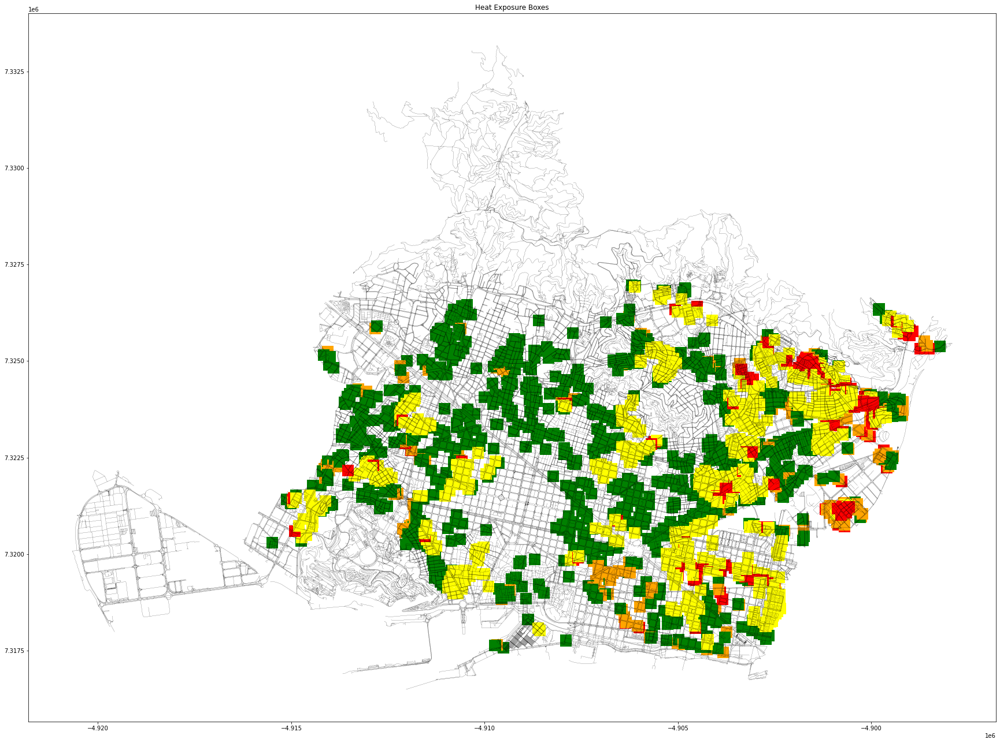

In [ ]:
fig, ax = plt.subplots(figsize=(30,30))

edges.plot(ax=ax, linewidth=0.1, edgecolor='black')
nodes.plot(ax=ax, color='black', markersize=0.0003)

he_colors_dict={0:"green", 1:"yellow", 2:"orange", 3:"red"}
he_colors=[he_colors_dict[i] for i in heat_exposure_areas["encoded_classes"] ]
heat_exposure_boxes.plot( ax=ax, facecolor=he_colors, linewidth=0.6)

ax.set_title("Heat Exposure Boxes")
plt.show()

---

In [ ]:
nearest_points_spatial_index_to_heat_exposure_areas=Points_from_Nodes.sindex.query(heat_exposure_boxes)
print(f'centroids and graph nodes spatial index - Heat Exposure {nearest_points_spatial_index_to_heat_exposure_areas}')  #[0] first array is the indicies of each box and [1] the second array is the indicies of the included graph points
print(nearest_points_spatial_index_to_heat_exposure_areas.shape)

centroids and graph nodes spatial index - Heat Exposure [[    0     0     0 ...  1712  1712  1712]
 [39847  9737 23242 ... 11380 58415 58413]]
(2, 108085)


Now we need to know the class of each box (first array), so we can find out what are the Graph nodes selected by a certain class.

Let's firsy group the nodes selected by each box in one list, so we will have list of lists. the outer list should has a lenght = shape[1] of the above array, while the inner lists will have length = to number of nodes selected by each box

In [ ]:
from itertools import groupby
grouped_boxes=[list(grp) for k, grp in groupby(nearest_points_spatial_index_to_heat_exposure_areas[0])]
print(grouped_boxes)

[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], [2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2], [3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3], [4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4], [5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5

In [ ]:
len(grouped_boxes)#make sure all the boxes have selected some graph nodes (at least one)

1713

In [ ]:
grouped_nodes=[]
start_index=0
for j in grouped_boxes:
  end_index=start_index+len(j)
  inner_list=list(nearest_points_spatial_index_to_heat_exposure_areas[1][start_index:end_index])
  grouped_nodes.append(inner_list)
  start_index=end_index

In [ ]:
len(grouped_nodes)

1713

Make sure inner lists have the same length in both groups

In [ ]:
for i, j in zip(grouped_boxes,grouped_nodes):
  if len(i)!=len(j):
    print("mistake")
    print(len(i))
    print(len(j))

Now let's get the class of each box

In [ ]:
grouped_boxes_classes=[]
for i in grouped_boxes:
  inner=[]
  for j in i:
    inner.append(heat_exposure_areas["encoded_classes"].iloc[j]) #iloc should be the same as loc here as the gdf is #indexed from 0 to its length-1
  grouped_boxes_classes.append(inner)
print(grouped_boxes_classes)

[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

check

In [ ]:
for i, j in zip(grouped_boxes,grouped_boxes_classes):
  if len(i)!=len(j):
    print("mistake")
    print(len(i))
    print(len(j))

---
---
---

The following dict is keyed by each class and valued by the nodes index selecten by this class

In [ ]:
class_dict={0:[], 1:[], 2:[], 3:[]}
for i,j in enumerate(grouped_boxes_classes):
  class_dict[j[0]].extend(grouped_nodes[i])  #0 or any number withtin the length
print(class_dict)


{0: [39847, 9737, 23242, 39846, 9735, 9734, 39845, 23411, 22102, 41935, 36690, 23410, 9089, 39843, 2256, 9090, 9736, 23249, 23247, 23401, 36658, 36659, 37297, 975, 23248, 23252, 39870, 41937, 40812, 41936, 38335, 23250, 23251, 23760, 23253, 39834, 31108, 31107, 9061, 27320, 9059, 39871, 971, 974, 9060, 53432, 9799, 53431, 31106, 39869, 53430, 390, 392, 391, 389, 53286, 387, 53287, 5377, 5376, 53288, 386, 388, 67335, 34281, 34280, 41892, 5379, 41617, 53369, 53358, 293, 337, 5378, 336, 67336, 67342, 335, 53366, 333, 53289, 1988, 53296, 383, 382, 385, 384, 53290, 53291, 31474, 53294, 41891, 53292, 57063, 57062, 53376, 37946, 53375, 31477, 53377, 42289, 53295, 331, 42290, 53370, 37945, 37949, 31476, 53371, 31475, 16603, 53365, 334, 53364, 16604, 36663, 41616, 53368, 40677, 330, 40678, 41893, 329, 53372, 42292, 332, 41894, 42291, 24169, 24167, 64149, 64153, 24166, 64151, 46130, 64150, 64189, 64187, 24168, 64188, 64183, 4103, 64184, 64185, 4102, 46131, 4094, 68891, 4092, 4093, 64179, 4100, 6

In [ ]:
class0_counter=Counter(class_dict[0])
class1_counter=Counter(class_dict[1])
class2_counter=Counter(class_dict[2])
class3_counter=Counter(class_dict[3])

The following dict is keyed by the points index (graph nodes spatial index) and keyed by a list represents howmany times it is selected by class0, class1, class2, class3

In [ ]:
points_classes={}
for i in tqdm(Points_from_Nodes.index):
  points_classes[i]=[]

  points_classes[i].append(class0_counter[i])  #how many times selected by class0 (if the node index is not in the counter, it will return 0)
  points_classes[i].append(class1_counter[i])  #how many times selected by class1 (if the node index is not in the counter, it will return 0)
  points_classes[i].append(class2_counter[i])  #how many times selected by class2 (if the node index is not in the counter, it will return 0)
  points_classes[i].append(class3_counter[i])  #how many times selected by class3 (if the node index is not in the counter, it will return 0)
print(points_classes)

100%|██████████| 72427/72427 [00:00<00:00, 452273.58it/s]


{0: [0, 0, 0, 0], 1: [0, 0, 0, 0], 2: [0, 0, 0, 0], 3: [0, 0, 0, 0], 4: [0, 0, 0, 0], 5: [0, 0, 0, 0], 6: [0, 0, 0, 0], 7: [2, 0, 1, 0], 8: [2, 0, 1, 0], 9: [2, 0, 1, 0], 10: [1, 0, 1, 0], 11: [1, 0, 0, 0], 12: [1, 0, 0, 0], 13: [1, 0, 0, 0], 14: [0, 0, 0, 0], 15: [0, 0, 0, 0], 16: [0, 0, 0, 0], 17: [0, 0, 0, 0], 18: [0, 0, 0, 0], 19: [0, 0, 0, 0], 20: [0, 0, 0, 0], 21: [0, 0, 0, 0], 22: [0, 0, 0, 0], 23: [0, 0, 0, 0], 24: [0, 0, 0, 0], 25: [0, 0, 0, 0], 26: [0, 0, 0, 0], 27: [0, 0, 0, 0], 28: [0, 0, 0, 0], 29: [0, 0, 0, 0], 30: [0, 0, 0, 0], 31: [0, 0, 0, 0], 32: [0, 0, 0, 0], 33: [0, 0, 0, 0], 34: [0, 0, 0, 0], 35: [0, 0, 0, 0], 36: [0, 0, 0, 0], 37: [0, 0, 0, 0], 38: [0, 0, 0, 0], 39: [0, 0, 0, 0], 40: [0, 0, 0, 0], 41: [0, 0, 0, 0], 42: [0, 0, 0, 0], 43: [0, 0, 0, 0], 44: [0, 0, 0, 0], 45: [0, 0, 0, 0], 46: [1, 0, 0, 0], 47: [0, 0, 0, 0], 48: [0, 0, 0, 0], 49: [1, 0, 0, 0], 50: [1, 0, 0, 0], 51: [1, 0, 0, 0], 52: [1, 0, 0, 0], 53: [0, 0, 0, 0], 54: [0, 0, 0, 0], 55: [0, 0, 0, 0], 5

Finally, let's assign the final class to each graph node according to the rules we mentioned above

In [ ]:
np.argmax([5,5,5,2])

0

In [ ]:
graph_node_final_class={}
for i,j in zip(points_classes.keys(),points_classes.values()) :
  if j[0]==j[1]==j[2]==j[3]==0:#uknown class
    graph_node_final_class[i]=4
  else:
    if max(j)>0 and Counter(j)[max(j)] == 1 :  #graph node not selected by tow classes the same number of times
      graph_node_final_class[i]=np.argmax(j)
    elif max(j)>0 and Counter(j)[max(j)] != 1 :#graph node is selected by tow or more classes the same number of times..we will asign the higher exposure class (remember 0<1<2<3)
      repeated_max=np.argwhere(j == np.amax(j))
      graph_node_final_class[i]=max(repeated_max).item()
print(graph_node_final_class)

{0: 4, 1: 4, 2: 4, 3: 4, 4: 4, 5: 4, 6: 4, 7: 0, 8: 0, 9: 0, 10: 2, 11: 0, 12: 0, 13: 0, 14: 4, 15: 4, 16: 4, 17: 4, 18: 4, 19: 4, 20: 4, 21: 4, 22: 4, 23: 4, 24: 4, 25: 4, 26: 4, 27: 4, 28: 4, 29: 4, 30: 4, 31: 4, 32: 4, 33: 4, 34: 4, 35: 4, 36: 4, 37: 4, 38: 4, 39: 4, 40: 4, 41: 4, 42: 4, 43: 4, 44: 4, 45: 4, 46: 0, 47: 4, 48: 4, 49: 0, 50: 0, 51: 0, 52: 0, 53: 4, 54: 4, 55: 4, 56: 4, 57: 4, 58: 4, 59: 0, 60: 0, 61: 0, 62: 0, 63: 0, 64: 4, 65: 4, 66: 4, 67: 4, 68: 4, 69: 4, 70: 4, 71: 4, 72: 4, 73: 4, 74: 4, 75: 4, 76: 4, 77: 4, 78: 4, 79: 4, 80: 4, 81: 4, 82: 4, 83: 4, 84: 4, 85: 4, 86: 4, 87: 4, 88: 4, 89: 4, 90: 4, 91: 4, 92: 4, 93: 4, 94: 4, 95: 4, 96: 4, 97: 4, 98: 4, 99: 2, 100: 2, 101: 2, 102: 4, 103: 4, 104: 4, 105: 4, 106: 4, 107: 4, 108: 4, 109: 4, 110: 4, 111: 4, 112: 4, 113: 4, 114: 4, 115: 4, 116: 4, 117: 4, 118: 4, 119: 4, 120: 4, 121: 4, 122: 4, 123: 4, 124: 4, 125: 4, 126: 4, 127: 4, 128: 4, 129: 4, 130: 4, 131: 4, 132: 4, 133: 4, 134: 4, 135: 4, 136: 4, 137: 4, 138: 

⭐ You can always print some values in each condition to better understand how it works

In [ ]:
print(len(graph_node_final_class.keys()))
print(len(nodes))
#must be the same

72427
72427


---
Finally.....

In [ ]:
nodes

,y,x,street_count,lon,lat,highway,ref,geometry,trees,woods,scrubs,classes
osmid,,,,,,,,,,,,
21638843,7.317306e+06,-4.910297e+06,3,2.187593,41.370365,NaN,NaN,POINT (-4910296.742 7317306.489),7,0,0,4
6831738685,7.317297e+06,-4.910305e+06,4,2.187627,41.370285,crossing,NaN,POINT (-4910304.936 7317296.552),8,0,0,4
8462014250,7.317312e+06,-4.910299e+06,4,2.187542,41.370370,NaN,NaN,POINT (-4910299.305 7317311.897),5,0,0,4
6831706284,7.317342e+06,-4.910226e+06,4,2.187666,41.370875,crossing,NaN,POINT (-4910226.491 7317341.791),4,0,0,4
21638845,7.317269e+06,-4.910322e+06,3,2.187743,41.370092,NaN,NaN,POINT (-4910322.392 7317269.324),15,0,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...
11882035043,7.325779e+06,-4.907197e+06,1,2.140435,41.417339,NaN,NaN,POINT (-4907196.916 7325779.327),78,0,0,4
11882082426,7.324805e+06,-4.907507e+06,1,2.146082,41.412191,NaN,NaN,POINT (-4907507.302 7324804.845),5,0,0,0
11882082430,7.324816e+06,-4.907491e+06,3,2.146080,41.412318,NaN,NaN,POINT (-4907491.180 7324815.516),5,0,0,0


In [ ]:
nodes["classes"]=graph_node_final_class.values()
nodes

,y,x,street_count,lon,lat,highway,ref,geometry,trees,woods,scrubs,classes
osmid,,,,,,,,,,,,
21638843,7.317306e+06,-4.910297e+06,3,2.187593,41.370365,NaN,NaN,POINT (-4910296.742 7317306.489),7,0,0,4
6831738685,7.317297e+06,-4.910305e+06,4,2.187627,41.370285,crossing,NaN,POINT (-4910304.936 7317296.552),8,0,0,4
8462014250,7.317312e+06,-4.910299e+06,4,2.187542,41.370370,NaN,NaN,POINT (-4910299.305 7317311.897),5,0,0,4
6831706284,7.317342e+06,-4.910226e+06,4,2.187666,41.370875,crossing,NaN,POINT (-4910226.491 7317341.791),4,0,0,4
21638845,7.317269e+06,-4.910322e+06,3,2.187743,41.370092,NaN,NaN,POINT (-4910322.392 7317269.324),15,0,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...
11882035043,7.325779e+06,-4.907197e+06,1,2.140435,41.417339,NaN,NaN,POINT (-4907196.916 7325779.327),78,0,0,4
11882082426,7.324805e+06,-4.907507e+06,1,2.146082,41.412191,NaN,NaN,POINT (-4907507.302 7324804.845),5,0,0,0
11882082430,7.324816e+06,-4.907491e+06,3,2.146080,41.412318,NaN,NaN,POINT (-4907491.180 7324815.516),5,0,0,0


###Get a dgl graph

⭐ If you will use the graph for an edge classification part consider adding the
`fix repeatiion` section in the other notebook to fix the repeated edges problem

In [ ]:
nodes

,y,x,street_count,lon,lat,highway,ref,geometry,trees,woods,scrubs,classes
osmid,,,,,,,,,,,,
21638843,7.317306e+06,-4.910297e+06,3,2.187593,41.370365,NaN,NaN,POINT (-4910296.742 7317306.489),7,0,0,4
6831738685,7.317297e+06,-4.910305e+06,4,2.187627,41.370285,crossing,NaN,POINT (-4910304.936 7317296.552),8,0,0,4
8462014250,7.317312e+06,-4.910299e+06,4,2.187542,41.370370,NaN,NaN,POINT (-4910299.305 7317311.897),5,0,0,4
6831706284,7.317342e+06,-4.910226e+06,4,2.187666,41.370875,crossing,NaN,POINT (-4910226.491 7317341.791),4,0,0,4
21638845,7.317269e+06,-4.910322e+06,3,2.187743,41.370092,NaN,NaN,POINT (-4910322.392 7317269.324),15,0,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...
11882035043,7.325779e+06,-4.907197e+06,1,2.140435,41.417339,NaN,NaN,POINT (-4907196.916 7325779.327),78,0,0,4
11882082426,7.324805e+06,-4.907507e+06,1,2.146082,41.412191,NaN,NaN,POINT (-4907507.302 7324804.845),5,0,0,0
11882082430,7.324816e+06,-4.907491e+06,3,2.146080,41.412318,NaN,NaN,POINT (-4907491.180 7324815.516),5,0,0,0


In [ ]:
#Set nodes attributes
dic_trees={}
dic_woods={}
dic_scrubs={}
dic_proximity_cluster_index={}

dic_classes={}
dic_gdf_order={}

#x and y are already in the graph .. check nx.get_node_attributes(G, "x")

for i,j in enumerate(G.nodes()):      #j is the node id
  #print(i)
  dic_trees[j]=nodes['trees'].iloc[i]
  dic_woods[j]=nodes['woods'].iloc[i]
  dic_scrubs[j]=nodes['scrubs'].iloc[i]
  dic_proximity_cluster_index[j]=nodes['proximity_cluster_index'].iloc[i]

  dic_classes[j]= nodes['classes'].iloc[i]
  #also store the original node order for plotting later
  dic_gdf_order[j]= i


nx.set_node_attributes(G,dic_trees,'trees')
nx.set_node_attributes(G,dic_woods,'woods')
nx.set_node_attributes(G,dic_scrubs,'scrubs')
nx.set_node_attributes(G,dic_proximity_cluster_index,'proximity_cluster_index')
nx.set_node_attributes(G,dic_gdf_order,'gdf_order')

nx.set_node_attributes(G,dic_classes,'classes')

check

In [ ]:
print(nx.get_node_attributes(G, "classes"))

{21638843: 4, 6831738685: 4, 8462014250: 4, 6831706284: 4, 21638845: 4, 885308258: 4, 885308314: 4, 21638855: 0, 1401485279: 0, 4229056903: 0, 6831706278: 2, 21638859: 0, 3643971036: 0, 689473874: 0, 6831706254: 4, 21638861: 4, 6984806821: 4, 3643971040: 4, 9249495240: 4, 21638867: 4, 6984972069: 4, 1636238503: 4, 6984972072: 4, 6984972066: 4, 21638868: 4, 30343649: 4, 8253197813: 4, 8253197816: 4, 30343654: 4, 21638869: 4, 30343672: 4, 242318729: 4, 6984972029: 4, 6984972026: 4, 21638877: 4, 7159121700: 4, 6984927533: 4, 6984927536: 4, 6984927539: 4, 21638878: 4, 4433359262: 4, 6984927548: 4, 7159121709: 4, 7159121706: 4, 21638882: 4, 7159098030: 4, 7159194692: 0, 8984401689: 4, 8984401691: 4, 21638886: 0, 5006930486: 0, 6984806805: 0, 8253214823: 0, 21638889: 4, 3107096656: 4, 21638890: 4, 7254139889: 4, 8253147513: 4, 7254139891: 4, 21638891: 0, 190983324: 0, 8253147438: 0, 242284801: 0, 7254139899: 0, 21638916: 4, 21638917: 4, 190981834: 4, 10174169590: 4, 10174169592: 4, 21638919:

In [ ]:
#Get dgl graph
nodes_attributes_list=["x", "y", "trees", "woods", "scrubs", "proximity_cluster_index", "gdf_order", "classes"]
graph=dgl.from_networkx(G, node_attrs=nodes_attributes_list)

🌪 in the graph classification section, we didn't manage to directly add edge attributed while converting to a dgl graph, this is because the graphs were originally undirected, but the graph came from osmnx, is already a directed graph

In [ ]:
graph

Graph(num_nodes=72427, num_edges=233008,
      ndata_schemes={'x': Scheme(shape=(), dtype=torch.float64), 'y': Scheme(shape=(), dtype=torch.float64), 'trees': Scheme(shape=(), dtype=torch.int64), 'woods': Scheme(shape=(), dtype=torch.int64), 'scrubs': Scheme(shape=(), dtype=torch.int64), 'proximity_cluster_index': Scheme(shape=(), dtype=torch.int32), 'gdf_order': Scheme(shape=(), dtype=torch.int64), 'classes': Scheme(shape=(), dtype=torch.int64)}
      edata_schemes={})

In [ ]:
graph.nodes()  #notice that the nodes are all now renamed to new ids starting from 0

tensor([    0,     1,     2,  ..., 72424, 72425, 72426])

In [ ]:
graph.edges()  #also the edges as a result

(tensor([    0,     0,     0,  ..., 72394, 72409, 72422]),
 tensor([24761, 61879, 24760,  ..., 72395, 72408, 72421]))

---

In [ ]:
nodes_attributes_list[2:-2]  #ndata to include in the features vector

['trees', 'woods', 'scrubs', 'proximity_cluster_index']

In [ ]:
for i in nodes_attributes_list:
  graph.ndata[i]=torch.reshape(graph.ndata[i],(graph.ndata[i].shape[0],1))

graph.ndata["feat"]=torch.cat([graph.ndata[i] for i in nodes_attributes_list[2:-2]] ,1)
graph.ndata["feat"]=graph.ndata["feat"].type(torch.float32)

In [ ]:
print(G.number_of_edges())
print(graph.num_edges())

233008
233008


In order to represent an undirected graph in dgl, we need to let edges be in both directions

In [ ]:
graph=dgl.add_reverse_edges(graph)
print(G.number_of_edges())
print(graph.num_edges())

233008
465848


###Prepare the graph for a transductive node classification task

Split the dataset into:
- Train Nodes
- Validation Nodes
- Test Nodes
- Prediction Nodes (Nodes that we really don't know their classes "class 4 ")

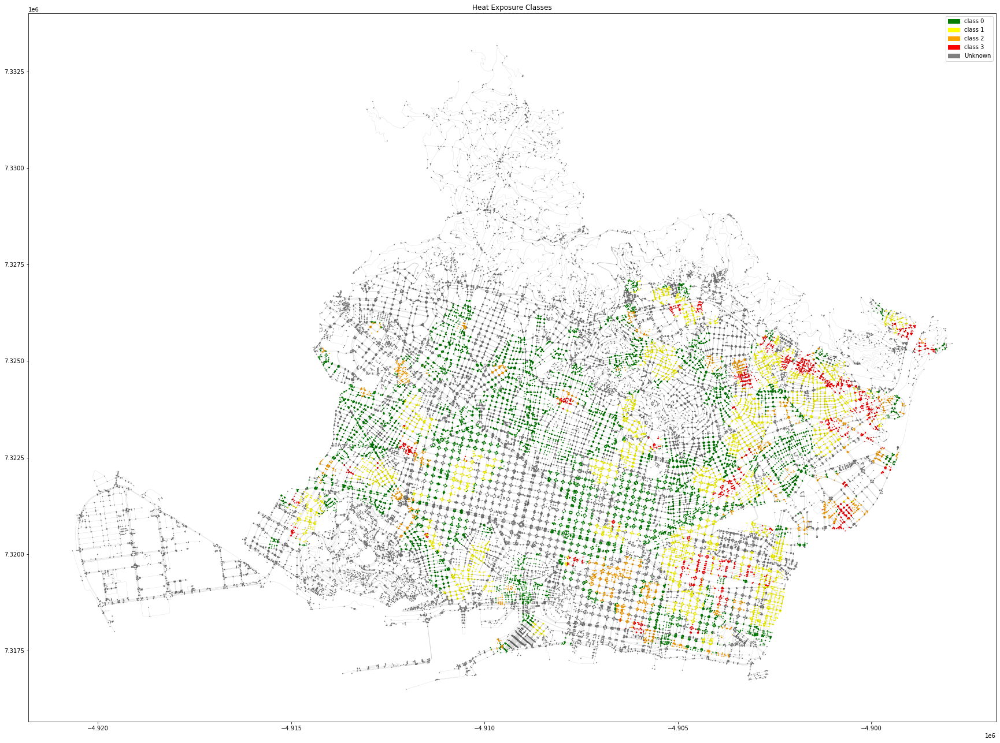

In [ ]:
fig, ax = plt.subplots(figsize=(30,30))
edges.plot(ax=ax, linewidth=0.03, edgecolor="black")
he_colors_dict={0:"green", 1:"yellow", 2:"orange", 3:"red", 4:"gray"}
he_colors=[he_colors_dict[i] for i in nodes["classes"] ]
nodes.plot( ax=ax, color=he_colors , markersize=0.6 , legend=True)
ax.set_title('Heat Exposure Classes')

#create a legend
c0 = mpatches.Patch(color=he_colors_dict[0], label='class 0')
c1 = mpatches.Patch(color=he_colors_dict[1], label='class 1')
c2 = mpatches.Patch(color=he_colors_dict[2], label='class 2')
c3 = mpatches.Patch(color=he_colors_dict[3], label='class 3')
c4 = mpatches.Patch(color=he_colors_dict[4], label='Unknown')

plt.legend(handles=[c0, c1, c2, c3, c4] )

plt.show()

Split the graph labels

For transductive node classification, we will split the graph nodes into Train, Validation and Test sets, **just in terms of labels** (classes), but the model will see all the features of all the nodes during training (including validation, test and prediction nodes)

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
graph.ndata["classes"].size()

torch.Size([72427, 1])

In [ ]:
Counter([i[0] for i in graph.ndata["classes"].tolist()])

Counter({4: 34335, 0: 20611, 2: 3529, 1: 10682, 3: 3270})

In [ ]:
labeled_nodes=[i.numpy().item() for i,j in zip(graph.nodes(),graph.ndata["classes"]) if j != 4]
un_labeled_nodes=[i.numpy().item() for i,j in zip(graph.nodes(),graph.ndata["classes"]) if j == 4]

print(len(labeled_nodes))
print(len(un_labeled_nodes))

38092
34335


In [ ]:
print(labeled_nodes)
print(un_labeled_nodes)

[2, 3, 11, 14, 29, 40, 41, 46, 49, 56, 58, 59, 60, 61, 62, 63, 65, 66, 67, 68, 69, 70, 72, 75, 84, 90, 91, 92, 95, 96, 97, 98, 101, 102, 103, 104, 113, 114, 115, 116, 117, 118, 119, 128, 129, 130, 133, 140, 142, 143, 144, 145, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 166, 167, 168, 169, 170, 171, 172, 173, 174, 179, 180, 181, 182, 183, 184, 187, 188, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 205, 206, 208, 209, 210, 211, 217, 220, 221, 222, 226, 227, 230, 231, 240, 242, 249, 252, 253, 257, 262, 263, 264, 265, 266, 267, 268, 269, 270, 277, 278, 279, 280, 289, 290, 291, 292, 294, 295, 296, 297, 299, 300, 301, 306, 307, 310, 311, 316, 317, 323, 324, 325, 326, 327, 328, 330, 331, 332, 333, 334, 335, 336, 338, 340, 341, 342, 343, 344, 345, 347, 349, 350, 351, 352, 354, 358, 361, 364, 369, 370, 371, 372, 373, 377, 379, 380, 381, 382, 383, 384, 385, 387, 388, 389, 390, 391, 392, 400, 401, 402, 403, 414, 415, 417, 418, 419, 422, 423, 424, 425, 426, 431, 432, 433, 434

In [ ]:
train_nodes, test_nodes= train_test_split(labeled_nodes, random_state=1, test_size=.1) #test
train_nodes, validation_nodes= train_test_split(train_nodes, random_state=1, test_size=.11)      #validation

prediction_nodes=un_labeled_nodes

print(len(train_nodes))
print(len(test_nodes))
print(len(validation_nodes))
print(len(prediction_nodes))

30510
3810
3772
34335


---
---
---

Create Train/ validation/ Test/ Prediction masks

Each mask is just a **boolean array** of the same size of the number of nodes, positions of nodes to be included are set to True, and the rest is False.

In [ ]:
print(sorted(train_nodes))
train_mask={i.numpy().item() :False for i in graph.nodes()}
print(train_mask)
[train_mask.update({n:True}) for n in train_nodes]
print(train_mask)

[3, 11, 29, 40, 41, 46, 56, 58, 59, 61, 62, 63, 65, 66, 67, 69, 70, 75, 84, 90, 91, 92, 95, 96, 98, 101, 102, 103, 104, 114, 115, 116, 118, 119, 128, 130, 133, 140, 142, 143, 144, 145, 149, 150, 151, 152, 153, 155, 156, 157, 158, 159, 166, 167, 168, 170, 171, 173, 174, 179, 180, 181, 182, 183, 184, 187, 188, 193, 194, 195, 196, 197, 199, 200, 203, 205, 206, 209, 211, 220, 222, 226, 227, 230, 231, 240, 242, 249, 253, 257, 262, 263, 264, 265, 266, 267, 268, 269, 277, 279, 289, 290, 292, 294, 295, 296, 297, 299, 300, 306, 307, 311, 323, 325, 327, 330, 331, 333, 334, 335, 338, 340, 342, 343, 345, 347, 349, 352, 354, 358, 364, 369, 370, 371, 372, 373, 379, 380, 381, 382, 383, 384, 385, 387, 388, 389, 390, 391, 401, 402, 414, 415, 418, 422, 423, 424, 426, 431, 432, 433, 434, 436, 437, 439, 440, 441, 443, 444, 445, 448, 451, 453, 455, 456, 458, 459, 460, 462, 463, 475, 477, 481, 482, 483, 484, 485, 486, 488, 490, 491, 494, 495, 497, 499, 500, 501, 503, 504, 505, 506, 507, 509, 510, 511, 513, 

Do the same for the rest of masks

In [ ]:
print(sorted(validation_nodes))
validation_mask={i.numpy().item() :False for i in graph.nodes()}
[validation_mask.update({n:True}) for n in validation_nodes]
print(validation_mask)

[2, 60, 72, 97, 113, 202, 210, 217, 278, 280, 291, 310, 316, 317, 326, 328, 336, 392, 442, 457, 496, 502, 525, 527, 535, 538, 564, 585, 613, 624, 632, 644, 692, 699, 712, 719, 723, 724, 739, 745, 746, 759, 784, 785, 786, 791, 814, 817, 830, 863, 865, 873, 882, 912, 915, 931, 933, 949, 951, 958, 981, 991, 995, 1019, 1028, 1056, 1064, 1067, 1100, 1106, 1107, 1108, 1111, 1154, 1158, 1162, 1166, 1204, 1259, 1286, 1296, 1298, 1322, 1344, 1352, 1358, 1385, 1389, 1396, 1411, 1417, 1487, 1499, 1511, 1512, 1524, 1535, 1550, 1556, 1557, 1562, 1633, 1636, 1716, 1733, 1740, 1803, 1806, 1814, 1816, 1824, 1844, 1857, 1859, 1865, 1879, 1892, 1929, 1970, 1978, 1994, 1996, 2006, 2040, 2048, 2061, 2077, 2093, 2099, 2112, 2114, 2135, 2140, 2150, 2197, 2210, 2212, 2232, 2240, 2251, 2273, 2303, 2317, 2321, 2328, 2329, 2360, 2406, 2431, 2451, 2453, 2457, 2461, 2483, 2505, 2523, 2582, 2589, 2595, 2654, 2798, 2827, 2845, 2903, 2926, 2928, 2936, 2941, 2979, 2992, 3016, 3038, 3084, 3136, 3146, 3239, 3264, 3267,

In [ ]:
print(sorted(test_nodes))
test_mask={i.numpy().item() :False for i in graph.nodes()}
[test_mask.update({n:True}) for n in test_nodes]
print(test_mask)

[14, 49, 68, 117, 129, 154, 169, 172, 198, 201, 208, 221, 252, 270, 301, 324, 332, 341, 344, 350, 351, 361, 377, 400, 403, 417, 419, 425, 438, 452, 454, 476, 489, 508, 518, 526, 545, 546, 560, 579, 588, 590, 621, 633, 681, 687, 734, 740, 744, 780, 812, 848, 864, 904, 952, 966, 968, 993, 1069, 1081, 1082, 1091, 1092, 1103, 1145, 1147, 1151, 1152, 1165, 1173, 1176, 1181, 1193, 1199, 1216, 1230, 1235, 1249, 1263, 1297, 1302, 1330, 1337, 1363, 1366, 1369, 1381, 1388, 1402, 1403, 1430, 1460, 1467, 1469, 1476, 1481, 1490, 1493, 1508, 1514, 1531, 1536, 1538, 1544, 1545, 1546, 1549, 1571, 1583, 1589, 1621, 1626, 1738, 1790, 1799, 1812, 1826, 1840, 1862, 1886, 1904, 1905, 1908, 1920, 1938, 1943, 1954, 1961, 1983, 1991, 1992, 2028, 2042, 2049, 2054, 2091, 2120, 2121, 2124, 2138, 2139, 2143, 2155, 2170, 2178, 2237, 2255, 2260, 2266, 2319, 2330, 2339, 2341, 2346, 2416, 2417, 2424, 2440, 2442, 2469, 2498, 2502, 2600, 2611, 2640, 2662, 2692, 2696, 2738, 2747, 2750, 2760, 2800, 2805, 2809, 2847, 2848

In [ ]:
print(sorted(prediction_nodes))
prediction_mask={i.numpy().item() :False for i in graph.nodes()}
[prediction_mask.update({n:True}) for n in prediction_nodes]
print(prediction_mask)

[0, 1, 4, 5, 6, 7, 8, 9, 10, 12, 13, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 42, 43, 44, 45, 47, 48, 50, 51, 52, 53, 54, 55, 57, 64, 71, 73, 74, 76, 77, 78, 79, 80, 81, 82, 83, 85, 86, 87, 88, 89, 93, 94, 99, 100, 105, 106, 107, 108, 109, 110, 111, 112, 120, 121, 122, 123, 124, 125, 126, 127, 131, 132, 134, 135, 136, 137, 138, 139, 141, 146, 147, 148, 160, 161, 162, 163, 164, 165, 175, 176, 177, 178, 185, 186, 189, 190, 191, 192, 204, 207, 212, 213, 214, 215, 216, 218, 219, 223, 224, 225, 228, 229, 232, 233, 234, 235, 236, 237, 238, 239, 241, 243, 244, 245, 246, 247, 248, 250, 251, 254, 255, 256, 258, 259, 260, 261, 271, 272, 273, 274, 275, 276, 281, 282, 283, 284, 285, 286, 287, 288, 293, 298, 302, 303, 304, 305, 308, 309, 312, 313, 314, 315, 318, 319, 320, 321, 322, 329, 337, 339, 346, 348, 353, 355, 356, 357, 359, 360, 362, 363, 365, 366, 367, 368, 374, 375, 376, 378, 386, 393, 394, 395, 396, 397, 398, 399, 404, 405, 406, 407, 

Check all the masks

In [ ]:
print(train_mask)
print(validation_mask)
print(test_mask)

{0: False, 1: False, 2: False, 3: True, 4: False, 5: False, 6: False, 7: False, 8: False, 9: False, 10: False, 11: True, 12: False, 13: False, 14: False, 15: False, 16: False, 17: False, 18: False, 19: False, 20: False, 21: False, 22: False, 23: False, 24: False, 25: False, 26: False, 27: False, 28: False, 29: True, 30: False, 31: False, 32: False, 33: False, 34: False, 35: False, 36: False, 37: False, 38: False, 39: False, 40: True, 41: True, 42: False, 43: False, 44: False, 45: False, 46: True, 47: False, 48: False, 49: False, 50: False, 51: False, 52: False, 53: False, 54: False, 55: False, 56: True, 57: False, 58: True, 59: True, 60: False, 61: True, 62: True, 63: True, 64: False, 65: True, 66: True, 67: True, 68: False, 69: True, 70: True, 71: False, 72: False, 73: False, 74: False, 75: True, 76: False, 77: False, 78: False, 79: False, 80: False, 81: False, 82: False, 83: False, 84: True, 85: False, 86: False, 87: False, 88: False, 89: False, 90: True, 91: True, 92: True, 93: Fals

In [ ]:
print(prediction_mask)

{0: True, 1: True, 2: False, 3: False, 4: True, 5: True, 6: True, 7: True, 8: True, 9: True, 10: True, 11: False, 12: True, 13: True, 14: False, 15: True, 16: True, 17: True, 18: True, 19: True, 20: True, 21: True, 22: True, 23: True, 24: True, 25: True, 26: True, 27: True, 28: True, 29: False, 30: True, 31: True, 32: True, 33: True, 34: True, 35: True, 36: True, 37: True, 38: True, 39: True, 40: False, 41: False, 42: True, 43: True, 44: True, 45: True, 46: False, 47: True, 48: True, 49: False, 50: True, 51: True, 52: True, 53: True, 54: True, 55: True, 56: False, 57: True, 58: False, 59: False, 60: False, 61: False, 62: False, 63: False, 64: True, 65: False, 66: False, 67: False, 68: False, 69: False, 70: False, 71: True, 72: False, 73: True, 74: True, 75: False, 76: True, 77: True, 78: True, 79: True, 80: True, 81: True, 82: True, 83: True, 84: False, 85: True, 86: True, 87: True, 88: True, 89: True, 90: False, 91: False, 92: False, 93: True, 94: True, 95: False, 96: False, 97: False

In [ ]:
print(graph.ndata["classes"])

tensor([[4],
        [4],
        [0],
        ...,
        [0],
        [0],
        [4]])


In [ ]:
print(nx.get_node_attributes(G,"classes"))

{21638843: 4, 6831738685: 4, 8462014250: 4, 6831706284: 4, 21638845: 4, 885308258: 4, 885308314: 4, 21638855: 0, 1401485279: 0, 4229056903: 0, 6831706278: 2, 21638859: 0, 3643971036: 0, 689473874: 0, 6831706254: 4, 21638861: 4, 6984806821: 4, 3643971040: 4, 9249495240: 4, 21638867: 4, 6984972069: 4, 1636238503: 4, 6984972072: 4, 6984972066: 4, 21638868: 4, 30343649: 4, 8253197813: 4, 8253197816: 4, 30343654: 4, 21638869: 4, 30343672: 4, 242318729: 4, 6984972029: 4, 6984972026: 4, 21638877: 4, 7159121700: 4, 6984927533: 4, 6984927536: 4, 6984927539: 4, 21638878: 4, 4433359262: 4, 6984927548: 4, 7159121709: 4, 7159121706: 4, 21638882: 4, 7159098030: 4, 7159194692: 0, 8984401689: 4, 8984401691: 4, 21638886: 0, 5006930486: 0, 6984806805: 0, 8253214823: 0, 21638889: 4, 3107096656: 4, 21638890: 4, 7254139889: 4, 8253147513: 4, 7254139891: 4, 21638891: 0, 190983324: 0, 8253147438: 0, 242284801: 0, 7254139899: 0, 21638916: 4, 21638917: 4, 190981834: 4, 10174169590: 4, 10174169592: 4, 21638919:

Notice the nodes in dgl graph don't keep their oroiginal order in osmnx.

**There must be only one True value for each index in one mask, and False in the rest of masks.**

---
---
---

Finally visualize the masks

Create a dict **keyed by osmnx original order** and **valued by the dgl index**

In [ ]:
reorder_dict={}
for i,j in enumerate([o.numpy().item() for o in graph.ndata["gdf_order"]]):
  reorder_dict[j]=i
print(reorder_dict)

{0: 0, 4: 1, 7: 2, 11: 3, 15: 4, 19: 5, 24: 6, 29: 7, 34: 8, 39: 9, 44: 10, 49: 11, 53: 12, 55: 13, 59: 14, 64: 15, 65: 16, 69: 17, 70: 18, 73: 19, 76: 20, 79: 21, 83: 22, 84: 23, 89: 24, 85: 25, 88: 26, 96: 27, 91: 28, 99: 29, 103: 30, 107: 31, 110: 32, 115: 33, 120: 34, 126: 35, 131: 36, 136: 37, 141: 38, 146: 39, 151: 40, 155: 41, 158: 42, 162: 43, 167: 44, 172: 45, 177: 46, 181: 47, 186: 48, 191: 49, 196: 50, 200: 51, 203: 52, 206: 53, 207: 54, 211: 55, 215: 56, 218: 57, 221: 58, 225: 59, 228: 60, 231: 61, 230: 62, 233: 63, 238: 64, 242: 65, 243: 66, 250: 67, 253: 68, 256: 69, 260: 70, 263: 71, 234: 72, 268: 73, 271: 74, 272: 75, 277: 76, 281: 77, 285: 78, 290: 79, 294: 80, 297: 81, 298: 82, 274: 83, 304: 84, 299: 85, 302: 86, 279: 87, 310: 88, 312: 89, 316: 90, 320: 91, 300: 92, 303: 93, 275: 94, 325: 95, 329: 96, 333: 97, 336: 98, 338: 99, 315: 100, 342: 101, 344: 102, 347: 103, 352: 104, 357: 105, 362: 106, 366: 107, 369: 108, 358: 109, 371: 110, 374: 111, 378: 112, 382: 113, 38

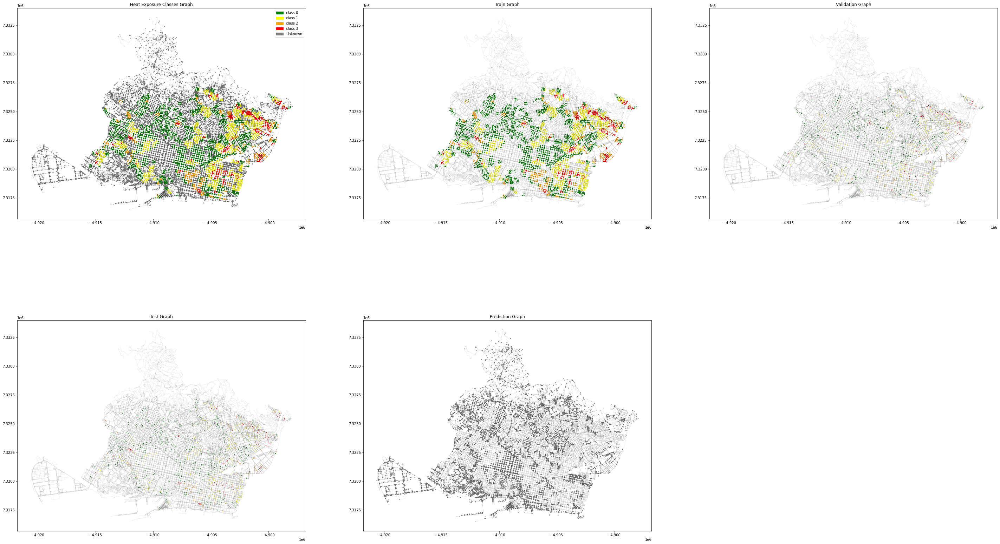

In [ ]:
fig = plt.figure(figsize=(50,30))
he_colors_dict={0:"green", 1:"yellow", 2:"orange", 3:"red", 4:"gray"}
classes_list=[t[0] for t in graph.ndata["classes"].tolist()]
classes_list_reordered=[classes_list[reorder_dict[i]] for i in sorted(reorder_dict.keys())]

out_of_mask_color="white"

# Graph
ax = fig.add_subplot(2,3,1)
edges.plot(ax=ax, linewidth=0.03, edgecolor="black")
he_colors=[he_colors_dict[i] for i in nodes["classes"]]
nodes.plot(ax=ax, color=he_colors , markersize=0.6 , legend=True)
ax.set_title('Heat Exposure Classes Graph')

c0 = mpatches.Patch(color=he_colors_dict[0], label='class 0')
c1 = mpatches.Patch(color=he_colors_dict[1], label='class 1')
c2 = mpatches.Patch(color=he_colors_dict[2], label='class 2')
c3 = mpatches.Patch(color=he_colors_dict[3], label='class 3')
c4 = mpatches.Patch(color=he_colors_dict[4], label='Unknown')

plt.legend(handles=[c0, c1, c2, c3, c4] )

#Train mask
ax = fig.add_subplot(2,3,2)
edges.plot(ax=ax, linewidth=0.03, edgecolor="black")

train_colors=[he_colors_dict[j] if train_mask[reorder_dict[i]]==True else out_of_mask_color for i,j in enumerate(classes_list_reordered) ] #dont use nodes["classes"] since the nodes order changed in dgl graph
nodes.plot(ax=ax, color=train_colors , markersize=0.6 , legend=True)
ax.set_title('Train Graph')

#Validation mask
ax = fig.add_subplot(2,3,3)
edges.plot(ax=ax, linewidth=0.03, edgecolor="black")

validation_colors=[he_colors_dict[j] if validation_mask[reorder_dict[i]]==True else out_of_mask_color for i,j in enumerate(classes_list_reordered) ]
nodes.plot(ax=ax, color=validation_colors , markersize=0.6 , legend=True)
ax.set_title('Validation Graph')

#Test mask
ax = fig.add_subplot(2,3,4)
edges.plot(ax=ax, linewidth=0.03, edgecolor="black")

test_colors=[he_colors_dict[j] if test_mask[reorder_dict[i]]==True else out_of_mask_color for i,j in enumerate(classes_list_reordered) ]
nodes.plot(ax=ax, color=test_colors , markersize=0.6 , legend=True)
ax.set_title('Test Graph')

#prediction mask
ax = fig.add_subplot(2,3,5)
edges.plot(ax=ax, linewidth=0.03, edgecolor="black")

prediction_colors=[he_colors_dict[j] if prediction_mask[reorder_dict[i]]==True else out_of_mask_color for i,j in enumerate(classes_list_reordered) ]
nodes.plot(ax=ax, color=prediction_colors , markersize=0.6 , legend=True)
ax.set_title('Prediction Graph')

plt.show()

Add the masks to the graph

In [ ]:
torch.tensor(list(train_mask.values()))

tensor([False, False, False,  ...,  True, False, False])

In [ ]:
graph.ndata["train_mask"]=torch.tensor(list(train_mask.values()))
graph.ndata["validation_mask"]=torch.tensor(list(validation_mask.values()))
graph.ndata["test_mask"]=torch.tensor(list(test_mask.values()))
graph.ndata["prediction_mask"]=torch.tensor(list(prediction_mask.values()))

In [ ]:
graph

Graph(num_nodes=72427, num_edges=465848,
      ndata_schemes={'x': Scheme(shape=(1,), dtype=torch.float64), 'y': Scheme(shape=(1,), dtype=torch.float64), 'trees': Scheme(shape=(1,), dtype=torch.int64), 'woods': Scheme(shape=(1,), dtype=torch.int64), 'scrubs': Scheme(shape=(1,), dtype=torch.int64), 'proximity_cluster_index': Scheme(shape=(1,), dtype=torch.int32), 'gdf_order': Scheme(shape=(1,), dtype=torch.int64), 'classes': Scheme(shape=(1,), dtype=torch.int64), 'feat': Scheme(shape=(4,), dtype=torch.float32), 'train_mask': Scheme(shape=(), dtype=torch.bool), 'validation_mask': Scheme(shape=(), dtype=torch.bool), 'test_mask': Scheme(shape=(), dtype=torch.bool), 'prediction_mask': Scheme(shape=(), dtype=torch.bool)}
      edata_schemes={})

###Learning

**GNN Module**

In [ ]:
class SAGE(nn.Module):
    def __init__(self, in_feats, hid_feats, out_feats):
        super().__init__()
        self.conv1 = SAGEConv(in_feats=in_feats, out_feats=hid_feats, aggregator_type='mean')
        self.conv2 = SAGEConv(in_feats=hid_feats, out_feats=out_feats, aggregator_type='mean')

    def forward(self, graph, inputs):
        # inputs are features of nodes
        h = self.conv1(graph, inputs)
        h = F.relu(h)
        h = self.conv2(graph, h)
        return h

**Get the features and labels sizes**

In [ ]:
n_features=graph.ndata["feat"].shape[1]
classes_list=[t[0] for t in graph.ndata["classes"].tolist()]
n_labels=len(Counter(classes_list).keys())

**Hyperparametrs**

In [ ]:
n_hidden=16
lr=0.03
n_epochs=200
device='cpu'

In [ ]:
model = SAGE(in_feats=n_features, hid_feats=n_hidden, out_feats=n_labels)
optimizer = torch.optim.Adam(model.parameters(), lr=lr)
model_path="best_model"
torch.manual_seed(710)
best_val_acc = 0
best_test_acc = 0

features = graph.ndata['feat']
labels = graph.ndata['classes']
train_mask_1 = graph.ndata['train_mask']
val_mask_1 = graph.ndata['validation_mask']
test_mask_1 = graph.ndata['test_mask']

train_accs=[]
valid_accs=[]

for e in range(n_epochs):
    # Forward
    logits = model(graph, features)

    # Compute prediction
    pred = logits.argmax(1)

    # Compute loss
    # Note that you should only compute the losses of the nodes in the training set.
    loss = F.cross_entropy(logits[train_mask_1], labels[train_mask_1].squeeze())

    # Compute accuracy on training/validation/test
    train_acc = (pred[train_mask_1] == labels[train_mask_1]).float().mean()
    val_acc = (pred[val_mask_1] == labels[val_mask_1]).float().mean()
    # test_acc = (pred[test_mask_1] == labels[test_mask_1]).float().mean()

    train_accs.append(train_acc)
    valid_accs.append(val_acc)

    # Save the best validation accuracy and the corresponding test accuracy.
    if best_val_acc < val_acc:
        best_val_acc = val_acc
        torch.save(model.state_dict(), model_path)

    # Backward
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    print('In epoch {}, loss: {:.3f}, train acc: {:.3f}, val acc: {:.3f}'.format(e, loss, train_acc, val_acc))


###Evaluate and Complete the missing classes

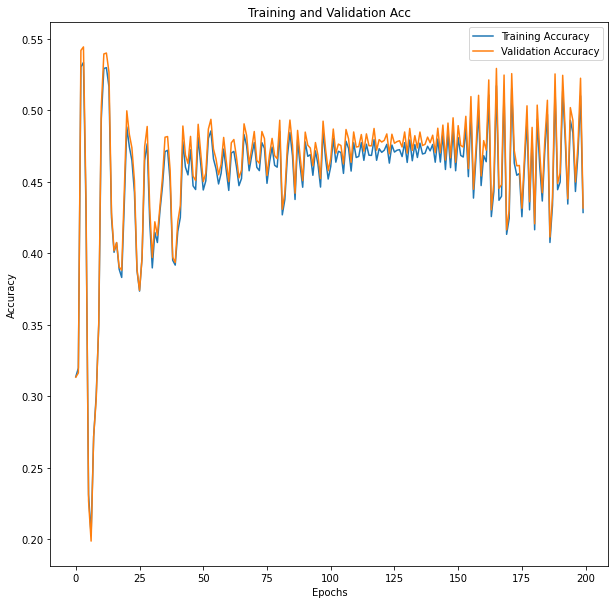

In [ ]:
%matplotlib inline
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(1,1,1)

plt.plot(range(n_epochs), [a.numpy().item() for a in train_accs], label='Training Accuracy')
plt.plot(range(n_epochs), [a.numpy().item() for a in valid_accs], label='Validation Accuracy')

# Add in a title and axes labels
plt.title('Training and Validation Acc')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')

# Display the plot
plt.legend(loc='best')
plt.show()

Test Ground truth vs prediction

In [ ]:
Counter([i.numpy().item() for i in pred]) #notice there is no any predictions of "class 4" the unknown class then it is never seen in training

Counter({0: 65902, 1: 5478, 2: 1013, 3: 34})

In [ ]:
Counter([i.numpy().item() for i in pred[test_mask_1]])

Counter({0: 3446, 1: 306, 2: 57, 3: 1})

Create a dict valued by the dgl index and keyed by osmnx original order

In [ ]:
reorder_dict={}
for i,j in enumerate([o.numpy().item() for o in graph.ndata["gdf_order"]]):
  reorder_dict[j]=i
print(reorder_dict)

{0: 0, 4: 1, 7: 2, 11: 3, 15: 4, 19: 5, 24: 6, 29: 7, 34: 8, 39: 9, 44: 10, 49: 11, 53: 12, 55: 13, 59: 14, 64: 15, 65: 16, 69: 17, 70: 18, 73: 19, 76: 20, 79: 21, 83: 22, 84: 23, 89: 24, 85: 25, 88: 26, 96: 27, 91: 28, 99: 29, 103: 30, 107: 31, 110: 32, 115: 33, 120: 34, 126: 35, 131: 36, 136: 37, 141: 38, 146: 39, 151: 40, 155: 41, 158: 42, 162: 43, 167: 44, 172: 45, 177: 46, 181: 47, 186: 48, 191: 49, 196: 50, 200: 51, 203: 52, 206: 53, 207: 54, 211: 55, 215: 56, 218: 57, 221: 58, 225: 59, 228: 60, 231: 61, 230: 62, 233: 63, 238: 64, 242: 65, 243: 66, 250: 67, 253: 68, 256: 69, 260: 70, 263: 71, 234: 72, 268: 73, 271: 74, 272: 75, 277: 76, 281: 77, 285: 78, 290: 79, 294: 80, 297: 81, 298: 82, 274: 83, 304: 84, 299: 85, 302: 86, 279: 87, 310: 88, 312: 89, 316: 90, 320: 91, 300: 92, 303: 93, 275: 94, 325: 95, 329: 96, 333: 97, 336: 98, 338: 99, 315: 100, 342: 101, 344: 102, 347: 103, 352: 104, 357: 105, 362: 106, 366: 107, 369: 108, 358: 109, 371: 110, 374: 111, 378: 112, 382: 113, 38

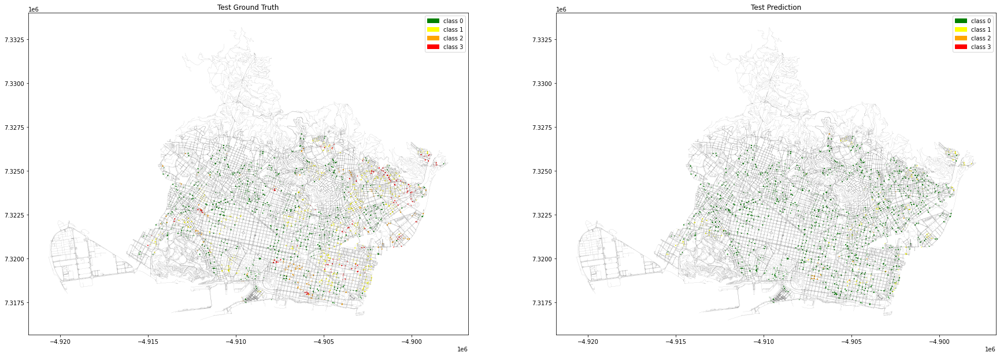

In [ ]:
fig = plt.figure(figsize=(30,15))
he_colors_dict={0:"green", 1:"yellow", 2:"orange", 3:"red", 4:"gray"}

classes_list=[t[0] for t in graph.ndata["classes"].tolist()]
classes_list_reordered=[classes_list[reorder_dict[i]] for i in sorted(reorder_dict.keys())]

classes_predicted_list=[i.numpy().item() for i in pred]
classes_predicted_list_reordered=[classes_predicted_list[reorder_dict[i]] for i in sorted(reorder_dict.keys())]

out_of_mask_color="white"

#Test ground truth
ax = fig.add_subplot(1,2,1)
edges.plot(ax=ax, linewidth=0.03, edgecolor="black")

test_colors=[he_colors_dict[j] if test_mask[reorder_dict[i]]==True else out_of_mask_color for i,j in enumerate(classes_list_reordered) ]
nodes.plot(ax=ax, color=test_colors , markersize=1.1 , legend=True)
ax.set_title('Test Ground Truth')

c0 = mpatches.Patch(color=he_colors_dict[0], label='class 0')
c1 = mpatches.Patch(color=he_colors_dict[1], label='class 1')
c2 = mpatches.Patch(color=he_colors_dict[2], label='class 2')
c3 = mpatches.Patch(color=he_colors_dict[3], label='class 3')
# c4 = mpatches.Patch(color=he_colors_dict[4], label='Unknown')

plt.legend(handles=[c0, c1, c2, c3] )

#Test prediction
ax = fig.add_subplot(1,2,2)
edges.plot(ax=ax, linewidth=0.03, edgecolor="black")

test_colors=[he_colors_dict[j] if test_mask[reorder_dict[i]]==True else out_of_mask_color for i,j in enumerate(classes_predicted_list_reordered) ]
nodes.plot(ax=ax, color=test_colors , markersize=1.1 , legend=True)
ax.set_title('Test Prediction')

c0 = mpatches.Patch(color=he_colors_dict[0], label='class 0')
c1 = mpatches.Patch(color=he_colors_dict[1], label='class 1')
c2 = mpatches.Patch(color=he_colors_dict[2], label='class 2')
c3 = mpatches.Patch(color=he_colors_dict[3], label='class 3')
# c4 = mpatches.Patch(color=he_colors_dict[4], label='Unknown')

plt.legend(handles=[c0, c1, c2, c3] )



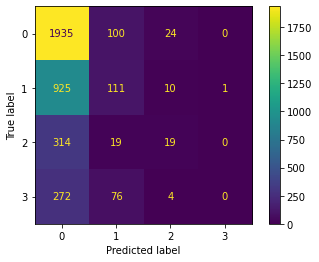

In [ ]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

y_test= labels[test_mask_1]
predictions = pred[test_mask_1]
cm = confusion_matrix(y_test, predictions, labels=[0,1,2,3])
disp = ConfusionMatrixDisplay(confusion_matrix=cm,display_labels=[0,1,2,3])
disp.plot()
plt.show()

---

Complete missing classes

In [ ]:
Counter([t[0] for t in graph.ndata["classes"].tolist()])

Counter({4: 34335, 0: 20611, 2: 3529, 1: 10682, 3: 3270})

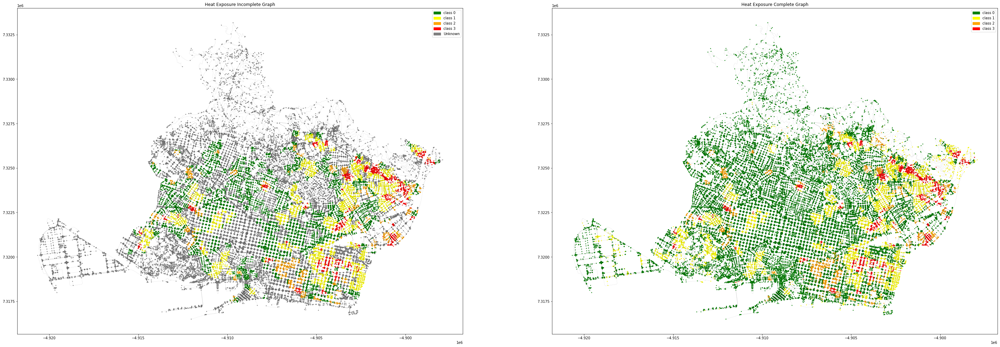

In [ ]:
fig = plt.figure(figsize=(50,25))
he_colors_dict={0:"green", 1:"yellow", 2:"orange", 3:"red", 4:"gray"}
g_nodes=[n.numpy().item() for n in graph.nodes()]

#in osmnx order for visualization
classes_list=[t[0] for t in graph.ndata["classes"].tolist()]
classes_list_reordered=[classes_list[reorder_dict[i]] for i in sorted(reorder_dict.keys())]

classes_predicted_list=[i.numpy().item() for i in pred]
classes_predicted_list_reordered=[classes_predicted_list[reorder_dict[i]] for i in sorted(reorder_dict.keys())]

out_of_mask_color="white"

# Graph
ax = fig.add_subplot(1,2,1)
edges.plot(ax=ax, linewidth=0.03, edgecolor="black")
he_colors=[he_colors_dict[i] for i in classes_list_reordered]
nodes.plot(ax=ax, color=he_colors , markersize=2 , legend=True)
ax.set_title('Heat Exposure Incomplete Graph')

c0 = mpatches.Patch(color=he_colors_dict[0], label='class 0')
c1 = mpatches.Patch(color=he_colors_dict[1], label='class 1')
c2 = mpatches.Patch(color=he_colors_dict[2], label='class 2')
c3 = mpatches.Patch(color=he_colors_dict[3], label='class 3')
c4 = mpatches.Patch(color=he_colors_dict[4], label='Unknown')

plt.legend(handles=[c0, c1, c2, c3, c4] )


#prediction mask
ax = fig.add_subplot(1,2,2)
edges.plot(ax=ax, linewidth=0.03, edgecolor="black")

#notice it is not prediction_mask[i], but prediction_mask[reorder_dict[i]].. always pay attention to the data structre
prediction_colors=[he_colors_dict[j] if prediction_mask[reorder_dict[i]]==True else he_colors_dict[k] for i,(j,k) in enumerate(zip(classes_predicted_list_reordered,classes_list_reordered))] #j predicte class that we don't know, k is real class that we already know
nodes.plot(ax=ax, color=prediction_colors , markersize=2 , legend=True)
ax.set_title('Heat Exposure Complete Graph')

c0 = mpatches.Patch(color=he_colors_dict[0], label='class 0')
c1 = mpatches.Patch(color=he_colors_dict[1], label='class 1')
c2 = mpatches.Patch(color=he_colors_dict[2], label='class 2')
c3 = mpatches.Patch(color=he_colors_dict[3], label='class 3')

plt.legend(handles=[c0, c1, c2, c3] )
plt.show()

---